# 전처리코드 제공 데이터에 맞춰서 진행


In [1]:
# from google.colab import drive
# drive.mount('/content/drive')

In [2]:
# # 한글폰트 사용 in colab
# %matplotlib inline  

# import matplotlib as mpl 
# import matplotlib.pyplot as plt 
# import matplotlib.font_manager as fm  

# !apt-get update -qq
# !apt-get install fonts-nanum* -qq

# path = '/usr/share/fonts/truetype/nanum/NanumBarunGothic.ttf' 
# font_name = fm.FontProperties(fname=path, size=10).get_name()
# print(font_name)
# plt.rc('font', family=font_name)

# fm._rebuild()
# mpl.rcParams['axes.unicode_minus'] = False

In [3]:
import pandas as pd
import numpy as np
import missingno as msno
import folium
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')

import os
import json
import time
from tqdm import tqdm
import warnings

import seaborn as sns
import matplotlib.pyplot as plt


warnings.filterwarnings("ignore")

In [4]:
def get_font_family():
    """
    시스템 환경에 따른 기본 폰트명을 반환하는 함수
    """
    import platform
    system_name = platform.system()
    # colab 사용자는 system_name이 'Linux'로 확인

    if system_name == "Darwin" :
        font_family = "AppleGothic"
    elif system_name == "Windows":
        font_family = "Malgun Gothic"
    else:
        # Linux
        # colab에서는 runtime을 <꼭> 재시작 해야함.
        # 런타임을 재시작 하지 않고 폰트 설치를 하면 기본 설정 폰트가 로드되어 한글이 깨짐.
        !apt-get update -qq
        !apt-get install fonts-nanum -qq  > /dev/null

        import matplotlib.font_manager as fm

        fontpath = '/usr/share/fonts/truetype/nanum/NanumBarunGothic.ttf'
        font = fm.FontProperties(fname=fontpath, size=9)
        fm._rebuild()
        font_family = "NanumBarunGothic"
    return font_family

# 시각화를 위한 폰트설정
# 위에서 만든 함수를 통해 시스템 폰트를 불러와서 font_family 라는 변수에 할당.
a = get_font_family()
# 폰트설정
import matplotlib.pyplot as plt 
plt.rc("font", family = a)
# 마이너스폰트 설정
plt.rc("axes", unicode_minus=False)

In [5]:
# 최대 컬럼설정
pd.set_option('display.max_columns', 50)

In [6]:
os.listdir("./data/")

['covid_19_dataset', 'KT_빅데이터플랫폼_데이터셋', '외부데이터']

In [7]:
os.listdir("./data/KT_빅데이터플랫폼_데이터셋")

['dlvr_call.csv',
 'popl.csv',
 'StartupOrClosing_Region_ver2.csv',
 'StartupOrClosing_Shop_ver2.csv',
 '전체 데이터 설명.hwp']

In [8]:
os.listdir("./data/외부데이터")

['hankuk2_geo.json',
 'KGU_2nd_ORIGIN_KGUWETHERINFO_20201031000000.csv',
 '공시지가_2019년.csv',
 '공시지가_2020년.csv',
 '시군구.json']

In [9]:
os.listdir("./data/covid_19_dataset")

['Case.csv',
 'PatientInfo.csv',
 'Policy.csv',
 'Region.csv',
 'SearchTrend.csv',
 'SeoulFloating.csv',
 'Time.csv',
 'TimeAge.csv',
 'TimeGender.csv',
 'TimeProvince.csv',
 'Weather.csv']

# 사용할 데이터 병합 (배달&날씨)

In [10]:
# 배달데이터 확인
delivery = pd.read_csv("./data/KT_빅데이터플랫폼_데이터셋/dlvr_call.csv")
delivery = delivery.rename(columns={'SN' : '순번',
'PROCESS_DT' : '처리일시',
'DLVR_REQUST_ENTRPS_ID' : '배달요청업체ID',
'DLVR_REQUST_STTUS_VALUE' : '배달요청상태값',
'DLVR_RCEPT_ENTRPS_ID' : '배달접수업체ID',
'DLVR_STORE_ID' : '배달상점ID',
'DLVR_STORE_INDUTY_NM' : '배달상점 업종명',
'DLVR_STORE_LEGALDONG_CODE' : '배달상점법정동코드',
'DLVR_STORE_BRTC_NM' : '배달상점광역시도명',
'DLVR_STORE_SIGNGU_NM' : '배달상점시군구명',
'DLVR_STORE_LEGALDONG_NM' : '배달상점법정동명',
'DLVR_STORE_LI_NM' : '배달상점리명',
'DLVR_STORE_ADSTRD_CODE' : '배달상점행정동코드',
'DLVR_STORE_RDNMADR_CODE' : '배달상점도로명주소 코드',
'DLVR_DSTN_LEGALDONG_CODE' : '배달목적지법정동코드',
'DLVR_DSTN_BRTC_NM' : '배달목적지광역시도명',
'DLVR_DSTN_SIGNGU_NM' : '배달목적지시군구명',
'DLVR_DSTN_LEGALDONG_NM' : '배달목적지법정동명',
'DLVR_DSTN_LI_NM' : '배달목적지 리명',
'DLVR_DSTN_ADSTRD_CODE' : '배달목적지행정동코드',
'DLVR_DSTN_RDNMADR_CODE' : '배달목적지도로명주소 코드',
'DLVR_MAN_ID' : '배달자ID',
'DLVR_AMOUNT' : '배달금액',
'CALL_RLAY_FEE_AMOUNT' : '호출중계수수료금액',
'GOODS_AMOUNT' : '상품금액',
'SETLE_KND_VALUE' : '결제종류값',
'SETLE_CARD_NM' : '결제카드명',
'DLVR_RCEPT_TIME' : '배달접수시간',
'DLVR_CARALC_TIME' : '배달배차시간',
'DLVR_RECPT_TIME' : '배달수령시간',
'DLVR_COMPT_TIME' : '배달완료시간',
'DLVR_CANCL_TIME' : '배달취소시간'})

delivery.drop("순번", axis=1, inplace=True)
display(delivery)

,처리일시,배달요청업체ID,배달요청상태값,배달접수업체ID,배달상점ID,배달상점 업종명,배달상점법정동코드,배달상점광역시도명,배달상점시군구명,배달상점법정동명,배달상점리명,배달상점행정동코드,배달상점도로명주소 코드,배달목적지법정동코드,배달목적지광역시도명,배달목적지시군구명,배달목적지법정동명,배달목적지 리명,배달목적지행정동코드,배달목적지도로명주소 코드,배달자ID,배달금액,호출중계수수료금액,상품금액,결제종류값,결제카드명,배달접수시간,배달배차시간,배달수령시간,배달완료시간,배달취소시간
0,2019-12-01,C000101,1,C000101,S0021950,족발/보쌈,1156013200,서울특별시,영등포구,신길동,\N,1156066000,115603000023,1159010800,서울특별시,동작구,대방동,\N,1159066000,115904157098,D0006140,3300,200,18000,1,승인:KB국민카드,2019-12-01 20:47:52,2019-12-01 20:48:11,2019-12-01 20:55:33,2019-12-01 21:00:15,\N
1,2019-12-01,C000099,1,C000099,S0039210,치킨,4128510200,경기도,고양시 일산동구,중산동,\N,4128552000,412854379205,4128510200,경기도,고양시 일산동구,중산동,\N,4128552000,412853193037,D0005898,2900,0,21900,1,승인:현대카드사,2019-12-01 21:58:07,2019-12-01 22:01:06,2019-12-01 22:20:53,2019-12-01 22:26:01,\N
2,2019-12-01,C000029,1,C000043,S0036135,치킨,4115010100,경기도,의정부시,의정부동,\N,4115051000,411504343421,4115011100,경기도,의정부시,녹양동,\N,4115062000,411504343083,D0000864,3500,200,19500,2,NaN,2019-12-01 22:20:31,2019-12-01 22:37:45,2019-12-01 22:58:27,2019-12-01 22:58:32,\N
3,2019-12-01,C000105,1,C000105,S0039956,돈까스/일식,4128510400,경기도,고양시 일산동구,장항동,\N,4128559000,412854379097,4128510500,경기도,고양시 일산동구,마두동,\N,4128556000,412854379158,D0001526,3500,0,18000,2,NaN,2019-12-01 21:40:39,2019-12-01 21:48:41,2019-12-01 22:06:35,2019-12-01 22:17:57,\N
4,2019-12-01,C000028,1,C000043,S0003074,치킨,4115010900,경기도,의정부시,금오동,\N,4115058000,411504343342,4115010900,경기도,의정부시,금오동,\N,4115058000,411503181019,D0000986,3500,200,18000,3,NaN,2019-12-01 19:44:37,2019-12-01 19:48:07,2019-12-01 19:54:30,2019-12-01 20:00:22,\N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4296266,2020-03-31,C000237,1,C000237,S0021188,족발/보쌈,4121010200,경기도,광명시,철산동,\N,4121060000,4.12103E+11,4121010200,경기도,광명시,철산동,\N,4121059000,4.12103E+11,D0009705,3300,300,20900,2,NaN,2020-03-31 23:56,2020-03-31 23:56,2020-04-01 0:14,2020-04-01 0:18,\N
4296267,2020-03-31,C000104,1,C000102,S0021967,치킨,1156013300,서울특별시,영등포구,대림동,\N,1156070000,1.15603E+11,1162010200,서울특별시,관악구,신림동,\N,1162065500,1.16204E+11,D0002307,6300,200,26000,1,승인:신한카드,2020-03-31 23:55,2020-03-31 23:55,2020-04-01 0:17,2020-04-01 0:26,\N
4296268,2020-03-31,C000224,1,C000224,S0035329,분식,4127110400,경기도,안산시 상록구,본오동,\N,4127156000,4.12713E+11,4127310100,경기도,안산시 단원구,고잔동,\N,4127353500,4.12734E+11,D0009816,5500,200,17000,1,승인:롯데카드사,2020-03-31 23:58,2020-03-31 23:59,2020-04-01 0:18,2020-04-01 0:30,\N
4296269,2020-03-31,C000130,1,C000130,S0002286,족발/보쌈,4128112300,경기도,고양시 덕양구,화정동,\N,4128162200,4.12813E+11,4128112800,경기도,고양시 덕양구,행신동,\N,4128165500,4.12814E+11,D0002233,4000,300,35000,2,NaN,2020-03-31 23:56,2020-04-01 0:01,2020-04-01 0:16,2020-04-01 0:23,\N


In [11]:
# 날씨데이터 확인
weather = pd.read_csv("./data/외부데이터/KGU_2nd_ORIGIN_KGUWETHERINFO_20201031000000.csv", names=['순번','시군구코드','광역시도명','시군구명','공개 일','공개 시간','강수 유형명','습도','1시간 강수량 값','기온','풍속','바람강도 유형명','동쪽서쪽바람유형명','풍향값','풍향카테고리명'])
weather.drop("순번", axis=1, inplace=True)
display(weather)

,시군구코드,광역시도명,시군구명,공개 일,공개 시간,강수 유형명,습도,1시간 강수량 값,기온,풍속,바람강도 유형명,동쪽서쪽바람유형명,풍향값,풍향카테고리명
0,42150,강원도,강릉시,20190101,0,없음,25,0,-0.3,4.5,약간강,east,228,SW
1,42820,강원도,고성군,20190101,0,없음,23,0,0.6,1.9,약,east,271,W
2,42170,강원도,동해시,20190101,0,없음,25,0,2.1,1.8,약,east,231,SW
3,42230,강원도,삼척시,20190101,0,없음,23,0,1.3,2,약,east,222,SW
4,42210,강원도,속초시,20190101,0,없음,20,0,1.2,0.1,약,east,7,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4019995,43111,충청북도,청주시 상당구,20201031,2300,비,99,0.5,9.9,0,약,none,281,W
4019996,43112,충청북도,청주시 서원구,20201031,2300,비,99,0.5,9.9,0,약,none,281,W
4019997,43114,충청북도,청주시 청원구,20201031,2300,비,99,0.5,9.9,0,약,none,281,W
4019998,43113,충청북도,청주시 흥덕구,20201031,2300,비,81,0.5,12.1,0,약,none,237,WSW


In [12]:
# 병합을 위한 키 생성 - 배달
delivery['처리일시'] = pd.to_datetime(delivery['처리일시'])

time_list = []
for x in tqdm(range(len(delivery))):
    time_list.append(delivery['배달수령시간'].iloc[x][10:13]) # space 바 포함

delivery['TIME'] = time_list

delivery['처리일시'] = delivery['처리일시'].astype(str)

# Key 생성
delivery['KEY'] = delivery['배달목적지광역시도명'] + str("_") + delivery['배달목적지시군구명'] + str("_") + delivery['처리일시'] + delivery['TIME']

delivery.drop("TIME", axis=1, inplace=True)

100%|████████████████████████████████████████████████████████████████████| 4296271/4296271 [00:37<00:00, 114443.03it/s]


In [13]:
# 병합을 위한 키 생성 - 날씨

# 날씨
weather['공개 일'] = pd.to_datetime(weather['공개 일'], format='%Y%m%d')

# key 생성을 위한 데이터 전처리
weather['공개 일'] = weather['공개 일'].astype(str)
weather['공개 시간'] = weather['공개 시간'].astype(str)

# 시간 단위 조정
weather['공개 시간'].replace("0"," 00", inplace=True)
weather['공개 시간'].replace("100"," 01", inplace=True)
weather['공개 시간'].replace("200"," 02", inplace=True)
weather['공개 시간'].replace("300"," 03", inplace=True)
weather['공개 시간'].replace("400"," 04", inplace=True)
weather['공개 시간'].replace("500"," 05", inplace=True)
weather['공개 시간'].replace("600"," 06", inplace=True)
weather['공개 시간'].replace("700"," 07", inplace=True)
weather['공개 시간'].replace("800"," 08", inplace=True)
weather['공개 시간'].replace("900"," 09", inplace=True)
weather['공개 시간'].replace("1000"," 10", inplace=True)
weather['공개 시간'].replace("1100"," 11", inplace=True)
weather['공개 시간'].replace("1200"," 12", inplace=True)
weather['공개 시간'].replace("1300"," 13", inplace=True)
weather['공개 시간'].replace("1400"," 14", inplace=True)
weather['공개 시간'].replace("1500"," 15", inplace=True)
weather['공개 시간'].replace("1600"," 16", inplace=True)
weather['공개 시간'].replace("1700"," 17", inplace=True)
weather['공개 시간'].replace("1800"," 18", inplace=True)
weather['공개 시간'].replace("1900"," 19", inplace=True)
weather['공개 시간'].replace("2000"," 20", inplace=True)
weather['공개 시간'].replace("2100"," 21", inplace=True)
weather['공개 시간'].replace("2200"," 22", inplace=True)
weather['공개 시간'].replace("2300"," 23", inplace=True)

# key 생성
weather['KEY'] = weather['광역시도명'] + str("_") + weather['시군구명'] + str("_") + weather['공개 일'] + weather['공개 시간']


In [14]:
# 배달데이터 & 날씨데이터 병합 
df = pd.merge(delivery, weather, how='inner', on='KEY')
df.drop("KEY", axis=1, inplace=True)

In [15]:
# 필요없는 데이터컬럼 제거
df.drop(['배달요청상태값','배달상점법정동코드','배달상점광역시도명','배달상점시군구명',
         '배달상점법정동명','배달상점리명','배달상점행정동코드','배달상점도로명주소 코드','시군구코드','결제종류값',
         '배달목적지법정동코드','배달목적지광역시도명','배달목적지시군구명','배달목적지법정동명',
         '배달목적지 리명','배달목적지행정동코드','배달목적지도로명주소 코드','결제카드명','공개 일',
         '바람강도 유형명', '동쪽서쪽바람유형명', '풍향값','풍향카테고리명','배달취소시간'], axis=1, inplace=True)

In [16]:
display(df)

,처리일시,배달요청업체ID,배달접수업체ID,배달상점ID,배달상점 업종명,배달자ID,배달금액,호출중계수수료금액,상품금액,배달접수시간,배달배차시간,배달수령시간,배달완료시간,광역시도명,시군구명,공개 시간,강수 유형명,습도,1시간 강수량 값,기온,풍속
0,2019-12-01,C000101,C000101,S0021950,족발/보쌈,D0006140,3300,200,18000,2019-12-01 20:47:52,2019-12-01 20:48:11,2019-12-01 20:55:33,2019-12-01 21:00:15,서울특별시,동작구,20,없음,73,0,0,1.1
1,2019-12-01,C000032,C000263,S0000738,카페/디저트,D0005977,3500,300,15500,2019-12-01 20:36:47,2019-12-01 20:40:14,2019-12-01 20:42:45,2019-12-01 20:57:30,서울특별시,동작구,20,없음,73,0,0,1.1
2,2019-12-01,C000032,C000264,S0000658,카페/디저트,D0003498,3300,300,22000,2019-12-01 19:40:15,2019-12-01 19:51:46,2019-12-01 20:12:13,2019-12-01 20:38:16,서울특별시,동작구,20,없음,73,0,0,1.1
3,2019-12-01,C000032,C000264,S0000745,카페/디저트,D0003483,3300,300,26500,2019-12-01 19:56:23,2019-12-01 20:14:18,2019-12-01 20:20:51,2019-12-01 20:32:16,서울특별시,동작구,20,없음,73,0,0,1.1
4,2019-12-01,C000101,C000101,S0028565,한식,D0006186,3300,300,22000,2019-12-01 20:22:03,2019-12-01 20:22:17,2019-12-01 20:33:07,2019-12-01 20:38:02,서울특별시,동작구,20,없음,73,0,0,1.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4182449,2020-03-31,C000026,C000026,S0039845,피자,D0002486,4600,55,26000,2020-03-31 23:33,2020-03-31 23:33,2020-03-31 23:42,2020-03-31 23:54,서울특별시,강북구,23,없음,33,0.0,11.8,2
4182450,2020-03-31,C000026,C000026,S0039845,피자,D0000283,4200,55,26000,2020-03-31 23:14,2020-03-31 23:15,2020-03-31 23:33,2020-03-31 23:39,서울특별시,강북구,23,없음,33,0.0,11.8,2
4182451,2020-03-31,C000026,C000026,S0039845,피자,D0000283,4800,55,21000,2020-03-31 23:20,2020-03-31 23:20,2020-03-31 23:33,2020-03-31 23:48,서울특별시,강북구,23,없음,33,0.0,11.8,2
4182452,2020-03-31,C000032,C000088,S0000631,카페/디저트,D0008366,3200,0,22000,2020-03-31 23:00,2020-03-31 23:00,2020-03-31 23:10,2020-03-31 23:14,경기도,수원시 권선구,23,없음,45,0.0,12.2,2.6


In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4182454 entries, 0 to 4182453
Data columns (total 21 columns):
 #   Column     Dtype 
---  ------     ----- 
 0   처리일시       object
 1   배달요청업체ID   object
 2   배달접수업체ID   object
 3   배달상점ID     object
 4   배달상점 업종명   object
 5   배달자ID      object
 6   배달금액       int64 
 7   호출중계수수료금액  int64 
 8   상품금액       int64 
 9   배달접수시간     object
 10  배달배차시간     object
 11  배달수령시간     object
 12  배달완료시간     object
 13  광역시도명      object
 14  시군구명       object
 15  공개 시간      object
 16  강수 유형명     object
 17  습도         int64 
 18  1시간 강수량 값  object
 19  기온         object
 20  풍속         object
dtypes: int64(4), object(17)
memory usage: 702.0+ MB


# 데이터 확인 전 전처리

In [18]:
# 습도, 기온, 풍속, 1시간당 강수량
print(df['습도'].min()) # -1
print(df['습도'].max())
print("====================")

print(df['기온'].min()) # -0.1
print(df['기온'].max()) # 결측치
print("====================")

print(df['풍속'].min()) # -1
print(df['풍속'].max()) # 결측치
print("====================")

# 오류 발생
# print(df['1시간 강수량 값'].min()) # str 이기에 계산 불가능
# print(df['1시간 강수량 값'].max()) # str 이기에 계산 불가능
# print("====================")


## 습도와 풍속, 1시간 강수량 값에 마이너스 값이 있을 수는 없다.

-1
100
-0.1
\N
-1
\N


In [19]:
# 1시간당 강수량 값에 str??? // 기온,풍속도 str이다.
# unique로 찾아보자

print(df['1시간 강수량 값'].unique()) # -1도 존재한다.
print("====================")
print(df['기온'].unique()) # \\N
print("====================")
print(df['풍속'].unique()) # \\N

['0' '0.5' '1.5' '1' '2' '0.2' '0.1' '0.3' '0.6' '0.4' '1.8' '3' '0.8'
 '1.3' '2.5' '1.2' '4' '4.5' '5' '4.6' '3.5' '5.5' '4.1' '-1' '2.2' '2.1'
 '3.1' '0.7' '1.1' 6.0 2.5 0.5 5.0 3.0 4.5 1.0 3.8 6.6 4.0 3.5 1.8 5.5 1.5
 2.0 9.5 1.1 0.0 4.7 5.6 6.5 1.7 0.8 0.2 0.1 0.4 0.3 2.1 1.4 2.4 1.3 0.6
 2.7 3.2 2.2 1.9 0.9 -1.0 0.7 4.3 1.2 5.2 4.4 1.6 3.1 3.9 8.5 8.3 9.0 7.0
 6.7 10.0 2.6 7.3 4.1 6.2 8.0 11.0 13.0 7.5 15.0 10.5 5.9 8.2 3.6]
['0' '-0.2' '-0.6' '-0.9' '1.7' '-0.7' '1.4' '0.8' '1.1' '-1' '1' '1.2'
 '-0.5' '0.3' '-0.3' '0.9' '1.5' '-0.1' '1.3' '4.4' '0.5' '2.4' '-1.2'
 '0.4' '-0.4' '0.2' '-1.7' '2.7' '2.1' '\\N' '5.5' '-0.8' '-1.9' '0.6'
 '1.6' '0.7' '5.6' '-1.1' '-1.6' '4.7' '6.5' '-2' '-1.8' '6.7' '4.8' '1.9'
 '5.8' '1.8' '5.2' '2' '0.1' '-4.9' '6' '-4.3' '4.9' '6.2' '4.2' '-3.1'
 '-3.4' '-3.6' '-2.4' '-4' '-1.4' '-2.3' '-2.5' '-4.5' '-1.3' '-2.2'
 '-3.7' '-4.6' '-3.5' '-2.6' '-4.2' '-3.8' '-5.3' '-5.5' '-5.2' '-5.4'
 '-2.9' '-4.1' '-2.7' '-3.3' '-4.7' '-5.7' '-6' '-5.9' '-5.1' '-9

In [20]:
# 1. 풍속, 기온에서 문자열을 제거한다.
# 2. 1시간당 강수량값, 풍속, 기온을 float 형태로 변환한다.
# 3. 1시간당 강수량 값과 습도, 풍속에서 0보다 작은 값을 제거한다.

# 1
before = len(df)
df = df[(df['풍속'] != '\\N') & (df['기온'] != '\\N')]
after = len(df)
print("기온,풍속 결측치 데이터 수 : ", before-after)

# 2 
df['1시간 강수량 값'] = df['1시간 강수량 값'].astype(float)
df['풍속'] = df['풍속'].astype(float)
df['기온'] = df['기온'].astype(float)

# 3
before = len(df)
df = df[(df['풍속'] >= 0) & (df['습도'] >= 0) & (df['1시간 강수량 값'] >= 0)]
after = len(df)
print("1시간 강수량 값 & 습도 & 풍속 이상치 데이터 수 : ", before-after)

기온,풍속 이상치 데이터 수 :  105076
1시간 강수량 값 & 습도 & 풍속 이상치 데이터 수 :  78591


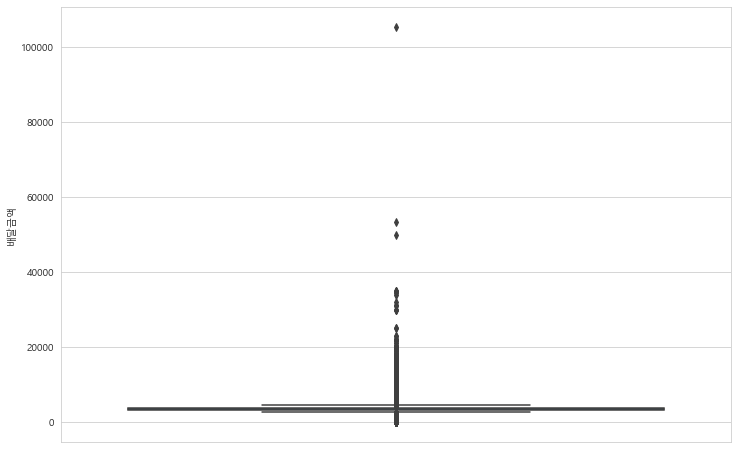

6500


In [21]:
# 배달금액, 호출중계수수료금액, 상품금액 파악 ==> 동시에 하니 안됨

# 배달금액
plt.figure(figsize=(12,8))
sns.boxplot(y='배달금액',data=df) # 6500원 이상은 이상치
plt.show()

print(df['배달금액'].quantile(q=0.99, interpolation='nearest'))

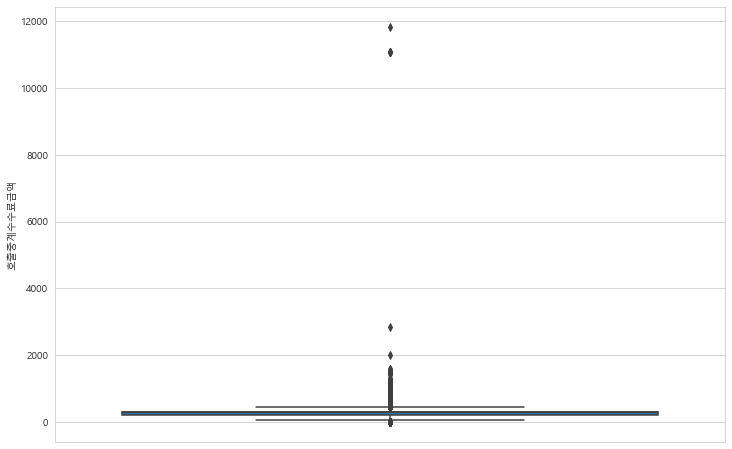

400


In [22]:
# 호출중계수수료금액
plt.figure(figsize=(12,8))
sns.boxplot(y='호출중계수수료금액',data=df) 
plt.show()

print(df['호출중계수수료금액'].quantile(q=0.99, interpolation='nearest'))# 400원 이상은 이상치

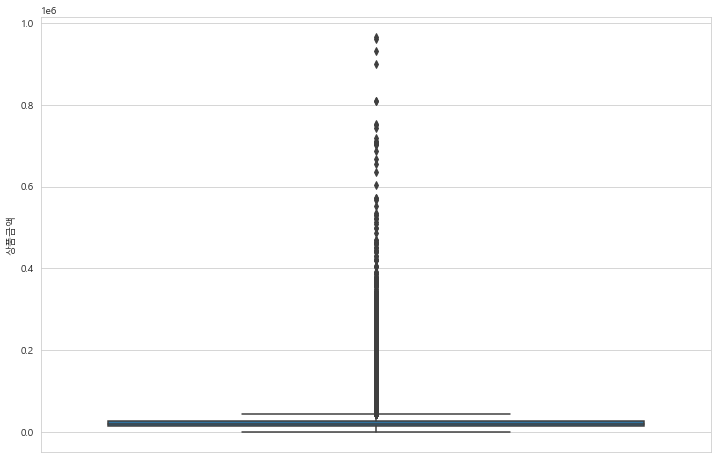

58800
2000


In [23]:
# 상품금액
plt.figure(figsize=(12,8))
sns.boxplot(y='상품금액',data=df)# 애매하다 / quantile로 봐야할 듯 하다.
plt.show()

print(df['상품금액'].quantile(q=0.99, interpolation='nearest')) # 58800원 이상은 이상치로 본다.
print(df['상품금액'].quantile(q=0.1, interpolation='nearest')) # 2000원 이하는 이상치

In [24]:
# 배달금액 / 호출중계수수료금액 / 상품금액 이상치 처리


before = len(df)
df = df[df['배달금액'] <= 6500]
df = df[df['호출중계수수료금액'] <= 400]
df = df[df['상품금액'] <= 58800]
coupon = df[df['상품금액'] == 0] # 쿠폰이 아닌 쿠팡이츠 결제 오류
df = df[df['상품금액'] != 0] 
after = len(df)

print("이상치 개수 :",before - after)

이상치 개수 : 472537


In [25]:
# 강수유형명 파악
print(df['강수 유형명'].unique())
# 없음 과 강수 2 가지로 파악 

['없음' '비' '진눈개비' '눈']


In [26]:
# 배달접수시간 / 배달배차시간 / 배달수령시간 / 배달완료시간 
# datetime 변환
df['배달접수시간'] = pd.to_datetime(df['배달접수시간'])
df['배달배차시간'] = pd.to_datetime(df['배달배차시간'])
df['배달수령시간'] = pd.to_datetime(df['배달수령시간'])
# df['배달완료시간'] = pd.to_datetime(df['배달완료시간']) # 오류 ==> 결측치 존재

before = len(df)
df = df[df['배달완료시간'] != '\\N']
after = len(df)
print("이상치 개수 :",before - after)

df['배달완료시간'] = pd.to_datetime(df['배달완료시간'])

이상치 개수 : 1047


# 파생변수 생성

1. 강수유형명이 아닌 강수 여부
2. 배달앱 각 진행단계별 걸린 시간
3. 배달시간을 계산할 수 있도록 float 값으로 변경
4. 코로나 영향을 판단하기 위한 변수 추가
5. 요일별 판단을 위한 변수 추가
6. 시간대별 주문 구분을 위한 변수 추가

In [27]:
# 강수유형명에 따른 강수 여부 구분 ==> 강수여부로 컬럼명 변환
df['강수 유형명'].replace("없음", "0", inplace=True) # 없음은 0 / 그 외는 1
df['강수 유형명'].replace("비", "1", inplace=True)
df['강수 유형명'].replace("눈", "1", inplace=True)
df['강수 유형명'].replace("진눈개비", "1", inplace=True)

df['강수 유형명'] = df['강수 유형명'].astype(int)

df.rename({'강수 유형명':'강수여부'}, inplace=True)

In [28]:
# 배달시간 컬럼 생성
df['라이더배치시간'] = df['배달배차시간'] - df['배달접수시간']
df['픽업이동시간'] = df['배달수령시간'] - df['배달배차시간']
df['순수배달시간'] = df['배달완료시간'] - df['배달수령시간']
df['총배달시간'] = df['배달완료시간'] - df['배달접수시간']

# 총배달시간 데이터 타입을 고려한 새로운 파생변수
deli_time = df['총배달시간'].to_list()
new_list = []
for time in tqdm(deli_time) :
    new_list.append(time.total_seconds() / 60)
df['배달시간계산'] = new_list

# 배달완료시각 및 주문접수시각 드롭
df = df.drop(['배달접수시간','배달배차시간','배달수령시간','배달완료시간'], axis=1)

100%|███████████████████████████████████████████████████████████████████| 3525203/3525203 [00:02<00:00, 1591398.04it/s]


In [29]:
# # 2020년 2~3월 : 신천지 (2월 18일 발생 시작 - 4월 29일 종료)
# # 2020sus 4월 30 ~ 

# 코로나 대확산에 따른 구분을 할 지 고민 (나중에 뽑아서 쓰면 되지 않을까?)
# 우선 코로나 전 후로 나누는 것으로


# 주문일자 구분 준비
df['처리일시'] = pd.to_datetime(df['처리일시'])


# # 4개로 나눠서 진행
# # 2019년 ~ 2020년 2월 17일까지
query1 = "처리일시 < '2020-02-18'"
date1 = df.query(query1)
date1['코로나'] = "전"

# # 2020년 2월 18일 ~ 
query2 = "처리일시 > '2020-02-17'"
date2 = df.query(query2)
date2['코로나'] = "후"

# 병합
df = pd.concat([date1, date2])

In [30]:
# 요일별 구분을 위한 요일 추가
df['처리일시'] = df['처리일시'].astype(str)
check_list = df['처리일시'].to_list()

dayofweek_list = []

for date in tqdm(check_list):
    day_name = pd.Timestamp(date).dayofweek
    if day_name == 0 :
        dayofweek_list.append("월요일")
    elif day_name == 1:
        dayofweek_list.append("화요일")
    elif day_name == 2:
        dayofweek_list.append("수요일")
    elif day_name == 3:
        dayofweek_list.append("목요일")
    elif day_name == 4:
        dayofweek_list.append("금요일")
    elif day_name == 5:
        dayofweek_list.append("토요일")
    else :
        dayofweek_list.append("일요일")
        
df['요일'] = dayofweek_list

100%|████████████████████████████████████████████████████████████████████| 3525203/3525203 [00:13<00:00, 254432.20it/s]


In [31]:
# 주문시각에 따른 분류

# 4개의 카테고리로 분류
# 17 ~ 20 ==> 저녁
# 21 ~ 23 ==> 야식
# 11 ~ 16 ==> 점심
# 0 ~ 10 ==> 기타

hour_list = df['공개 시간'].to_list()

etc = [0,1,2,3,4,5,6,7,8,9,10]
lunch = [11,12,13,14,15,16]
dinner = [17,18,19,20] 

hour_ctg_list = []
for hour in tqdm(hour_list) :
    if hour in etc :
        hour_ctg_list.append("기타")
    elif hour in lunch :
        hour_ctg_list.append("점심")
    elif hour in dinner :
        hour_ctg_list.append("저녁")
    else :
        hour_ctg_list.append("야식")
        
df['주문시각분류'] = hour_ctg_list

100%|███████████████████████████████████████████████████████████████████| 3525203/3525203 [00:03<00:00, 1169767.74it/s]


In [32]:
display(df.head())

,처리일시,배달요청업체ID,배달접수업체ID,배달상점ID,배달상점 업종명,배달자ID,배달금액,호출중계수수료금액,상품금액,광역시도명,시군구명,공개 시간,강수 유형명,습도,1시간 강수량 값,기온,풍속,라이더배치시간,픽업이동시간,순수배달시간,총배달시간,배달시간계산,코로나,요일,주문시각분류
0,2019-12-01,C000101,C000101,S0021950,족발/보쌈,D0006140,3300,200,18000,서울특별시,동작구,20,0,73,0.0,0.0,1.1,0 days 00:00:19,0 days 00:07:22,0 days 00:04:42,0 days 00:12:23,12.383333,전,일요일,야식
1,2019-12-01,C000032,C000263,S0000738,카페/디저트,D0005977,3500,300,15500,서울특별시,동작구,20,0,73,0.0,0.0,1.1,0 days 00:03:27,0 days 00:02:31,0 days 00:14:45,0 days 00:20:43,20.716667,전,일요일,야식
2,2019-12-01,C000032,C000264,S0000658,카페/디저트,D0003498,3300,300,22000,서울특별시,동작구,20,0,73,0.0,0.0,1.1,0 days 00:11:31,0 days 00:20:27,0 days 00:26:03,0 days 00:58:01,58.016667,전,일요일,야식
3,2019-12-01,C000032,C000264,S0000745,카페/디저트,D0003483,3300,300,26500,서울특별시,동작구,20,0,73,0.0,0.0,1.1,0 days 00:17:55,0 days 00:06:33,0 days 00:11:25,0 days 00:35:53,35.883333,전,일요일,야식
4,2019-12-01,C000101,C000101,S0028565,한식,D0006186,3300,300,22000,서울특별시,동작구,20,0,73,0.0,0.0,1.1,0 days 00:00:14,0 days 00:10:50,0 days 00:04:55,0 days 00:15:59,15.983333,전,일요일,야식


# 데이터 확인

In [33]:
# 전체 데이터 배달업체 관련 개수
print("배달요청업체ID : ",df['배달요청업체ID'].nunique())
print("배달접수업체ID : ",df['배달접수업체ID'].nunique())
print("배달상점ID : ",df['배달상점ID'].nunique())
print("배달자ID : ",df['배달자ID'].nunique())

배달요청업체ID :  94
배달접수업체ID :  119
배달상점ID :  8632
배달자ID :  4937


In [34]:
# 처리일시 범위를 봅시다 (19.12.01.~20.05.31.)
print(df['처리일시'].min())
print(df['처리일시'].max())

# 처리일시 datetime 변환
df['처리일시'] = pd.to_datetime(df['처리일시'])
# 년도-월 구분
df['Date'] = df['처리일시'].dt.strftime('%Y-%m')

# 구분을 위한 리스트화
date_list = df['Date'].unique()

2019-12-01
2020-05-31


#### 1. 배달상점과 라이더 수

100%|████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:03<00:00,  1.88it/s]


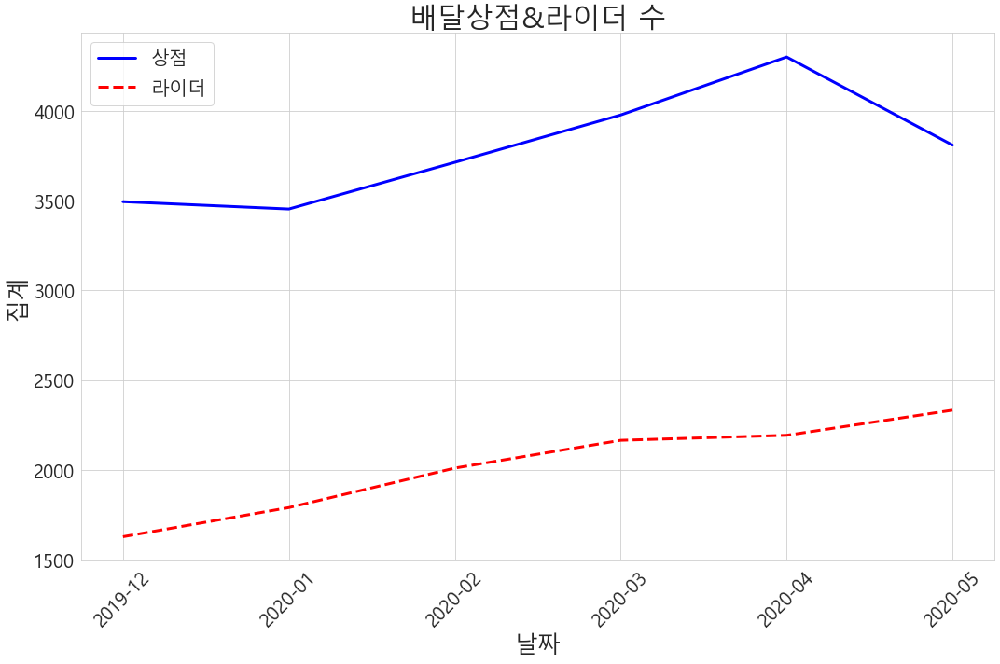

In [35]:
shop_list = []
rider_list = []

for x in tqdm(date_list) :
    check = df[df['Date']==x]
    shop_list.append(check['배달상점ID'].nunique())
    rider_list.append(check['배달자ID'].nunique())
#     print(x, "O2O 서비스 업체 수 :", check['배달상점ID'].nunique())
#     print(x, "배달대행업체 수 :", check['배달접수업체ID'].nunique())
#     print(x,"자영업자 수 :", check['배달상점ID'].nunique())
#     print(x, "라이더 수 :", check['배달자ID'].nunique())
#     print()

# 시각화용 자료 생성
visual_df = pd.DataFrame([date_list, shop_list, rider_list]).T
visual_df.columns = ['날짜', '배달상점 수', '라이더 수']

visual_df['배달상점 수'] = visual_df['배달상점 수'].astype(int)
visual_df['라이더 수'] = visual_df['라이더 수'].astype(int)

# 배달상점과 라이더 시간대별 파악

plt.figure(figsize=(15,10))
a = sns.lineplot(x='날짜', y='배달상점 수', data=visual_df, color='blue', linewidth=3)
sns.lineplot(x='날짜', y='라이더 수',data=visual_df, color='red', linewidth=3, linestyle='--')
plt.title('배달상점&라이더 수', fontsize=30)
plt.ylabel("집계", fontsize=25)
plt.xlabel("날짜", fontsize=25)
plt.xticks(rotation=45,fontsize=20)
plt.yticks(fontsize=20)
plt.legend(labels=('상점', '라이더'), fontsize=20)
plt.tight_layout()
plt.show()

#### 2. 폐업수

100%|███████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 501.41it/s]


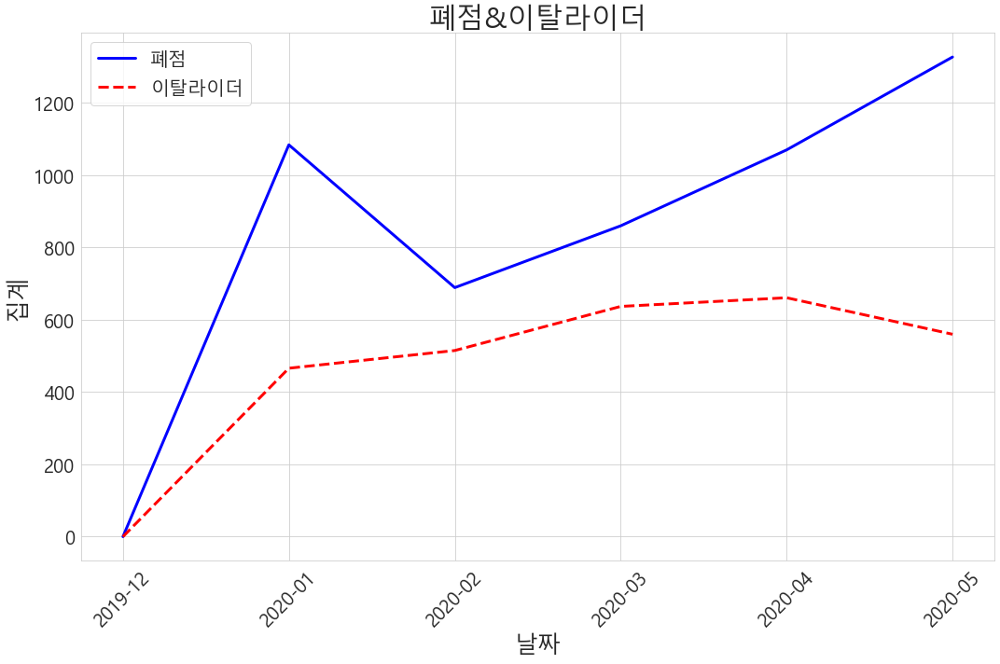

In [36]:
all_shop = []
all_rider = []

for x in tqdm(date_list) :
    check = df[df['Date']==x]
    all_shop.append(check['배달상점ID'].unique())
    all_rider.append(check['배달자ID'].unique())
    
close_shop = [0]
quit_rider = [0]

for zz in tqdm(range(len(date_list)-1)) :
    close_shop.append(len(set(all_shop[zz]) - set(all_shop[zz+1])))
    quit_rider.append(len(set(all_rider[zz]) - set(all_rider[zz+1])))
    
visual_df2 = pd.DataFrame([date_list, close_shop, quit_rider]).T
visual_df2.columns = ['날짜', '폐업상점 수', '이탈라이더']

visual_df2['폐업상점 수'] = visual_df2['폐업상점 수'].astype(int)
visual_df2['이탈라이더'] = visual_df2['이탈라이더'].astype(int)

# 배달상점과 라이더 시간대별 파악

plt.figure(figsize=(15,10))
a = sns.lineplot(x='날짜', y='폐업상점 수', data=visual_df2, color='blue', linewidth=3)
sns.lineplot(x='날짜', y='이탈라이더',data=visual_df2, color='red', linewidth=3, linestyle='--')
plt.title('폐점&이탈라이더', fontsize=30)
plt.ylabel("집계", fontsize=25)
plt.xlabel("날짜", fontsize=25)
plt.xticks(rotation=45,fontsize=20)
plt.yticks(fontsize=20)
plt.legend(labels=('폐점', '이탈라이더'), fontsize=20)
plt.tight_layout()
plt.show()

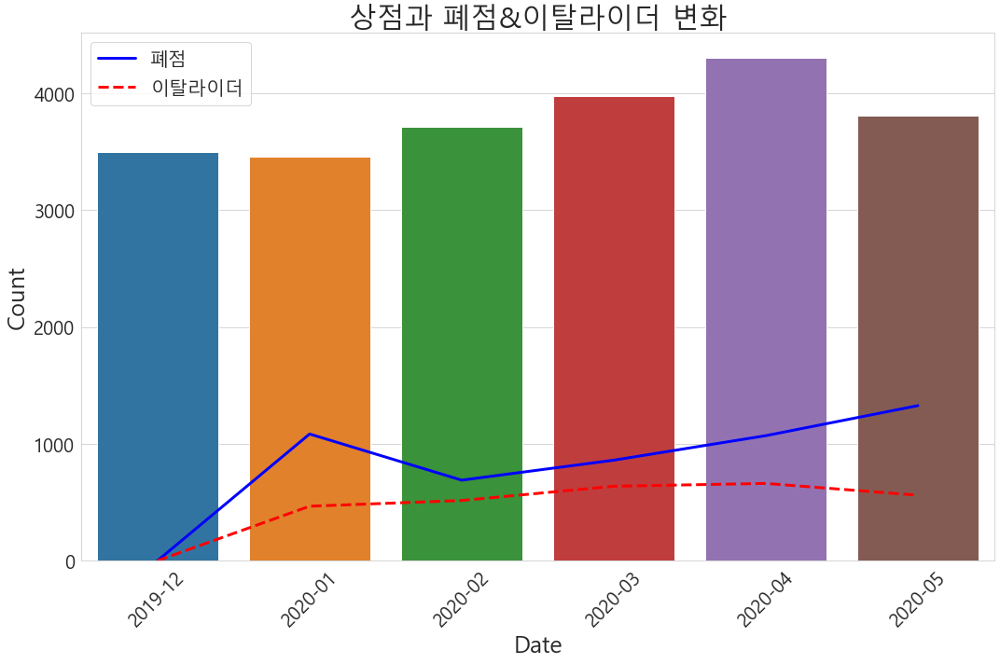

In [37]:
# 전체 배달건수 증가와 폐점 동시 시각화
plt.figure(figsize=(15,10))

sns.lineplot(x='날짜', y='폐업상점 수', data=visual_df2, color='blue', linewidth=3)
sns.lineplot(x='날짜', y='이탈라이더',data=visual_df2, color='red', linewidth=3, linestyle='--')
sns.barplot(x='날짜', y='배달상점 수', data=visual_df)
plt.title('상점과 폐점&이탈라이더 변화', fontsize=30)
plt.ylabel("Count", fontsize=25)
plt.xlabel("Date", fontsize=25)
plt.xticks(rotation=45,fontsize=20)
plt.yticks(fontsize=20)
plt.legend(labels=('폐점', '이탈라이더'), fontsize=20)
plt.tight_layout()
plt.show()

평균 폐점률 10.15
코로나 전 폐점률 : 7.14
코로나 후 폐점률 : 11.71


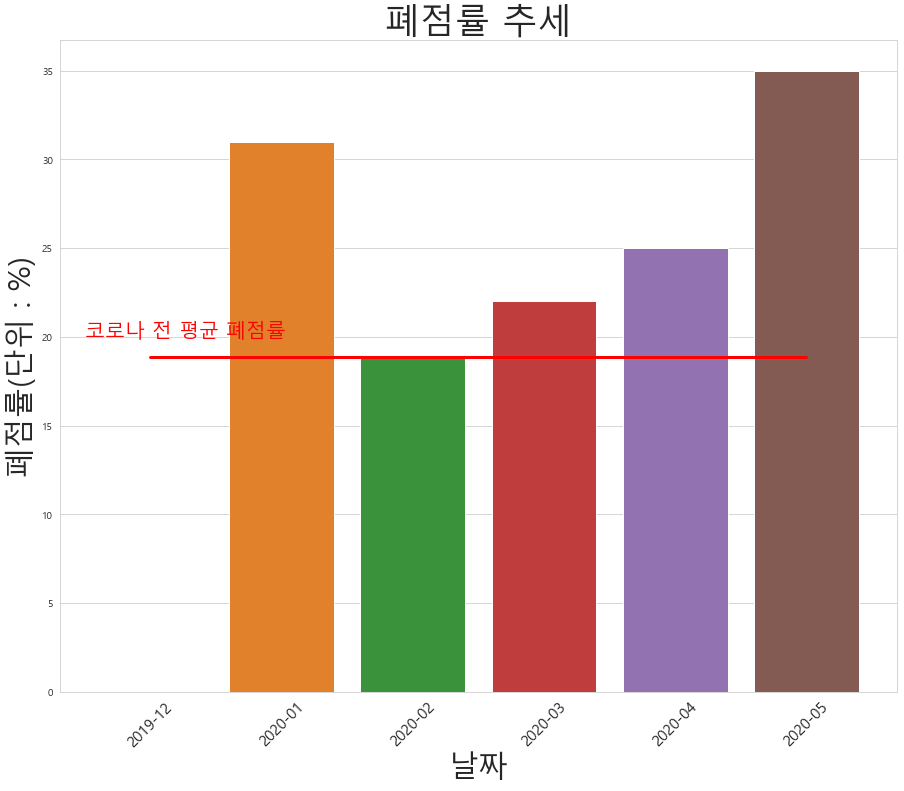

In [38]:
# 배달업체가 폐점한 곳은 코로나의 영향이 있었을까?
# O2O 산업이 성장함에 따라 배달상점 자체도 늘어났다.
# 그렇다면 모집단이 커지기 때문에 단순히 폐점하는 수가 많다고 해서 코로나로 인해 피해가 생겼다고 말할 수 없다.
# 때문에 그 비율로 확인할 필요가 있다.

closed_rate = [0]
for x in range(1, len(date_list)) :
    closed_rate.append(round(close_shop[x]/shop_list[x],2)*100)

closed_dataframe = pd.DataFrame([date_list, closed_rate]).T
closed_dataframe.columns = ['날짜', '폐점률(단위 : %)']
closed_dataframe
# 평균적으로 코로나 시기에 폐점률이 높다. ==> 시각화 진행 필요

print("평균 폐점률", round(sum(closed_rate[1:])/13,2))
print("코로나 전 폐점률 :",round(sum(closed_rate[1:3])/7,2))
print("코로나 후 폐점률 :",round(sum(closed_rate[3:])/7,2))


plt.figure(figsize=(15,12))
a = sns.barplot(data= closed_dataframe,x= "날짜", y='폐점률(단위 : %)')
sns.lineplot(x=closed_dataframe['날짜'], y=round(sum(closed_rate[1:7])/7,2), linewidth=3, color='red')
a.axes.set_title("폐점률 추세", fontsize=35) 
a.set_xlabel("날짜", fontsize=30) 
a.set_ylabel("폐점률(단위 : %)", fontsize=30)
plt.text(-0.5,20,"코로나 전 평균 폐점률", fontsize=20, color="red")
plt.xticks(rotation=45,fontsize=15)
plt.show()

In [39]:
# 실제 폐업 비교
# 창폐업 데이터 활용 (DATE가 창폐업 기준이 아니기 때문에, 모든 데이터의 폐업 수를 활용)

# 창폐업 데이터 불러오기
region = pd.read_csv("./data/KT_빅데이터플랫폼_데이터셋/StartupOrClosing_Region_ver2.csv")

# 서울만 남기기
seoul_region = region[region['BRTC_NM']=='서울']

# 위경도 값 확인
for x in tqdm(range(len(seoul_region))) :
    seoul_region['LA_DCMLPOINT_VALUE'].iloc[x] = seoul_region['LA_DCMLPOINT_VALUE'].iloc[x][:-3]
    seoul_region['LO_DCMLPOINT_VALUE'].iloc[x] = seoul_region['LO_DCMLPOINT_VALUE'].iloc[x][:-3]

# 데이터 타입 변환
seoul_region['LA_DCMLPOINT_VALUE'] = seoul_region['LA_DCMLPOINT_VALUE'].astype(float)
seoul_region['LO_DCMLPOINT_VALUE'] = seoul_region['LO_DCMLPOINT_VALUE'].astype(float)

# 폐업데이터만 남기기 ==> DIVISION == 0
seoul_region = seoul_region[seoul_region['DIVISION']==0]


# 창폐업 지역의 특성을 알아보기 위해 공시지가 데이터 사용
jiga_2020 = pd.read_csv("./data/외부데이터/공시지가_2020년.csv", encoding='cp949')
jiga1 = jiga_2020[['시도명','시군구명','공시지가(원/㎡)']]
sigungu = jiga1.groupby("시군구명", as_index=False).mean()

# 구단위 지도 그리기
geo_path = './data/외부데이터/시군구.json' # https://mkjjo.github.io/python/2019/08/18/seoul_map.html
geo_str = json.load(open(geo_path, encoding='utf-8')) # 딕셔너리 객체로 리턴


# 지도 색칠하기용 데이터 --> jiga1
# # 지역별, 동별 구분 경계선 
map = folium.Map(location=[37.5502, 126.982], zoom_start=13,
                 tiles='Stamen Terrain') # Stamen Toner / Stamen Terrain

nm = '공시지가(원/㎡)'
fmap=folium.Choropleth(geo_data = geo_str,
                       data = sigungu,
                       columns = ['시군구명',nm], 
                       fill_color='YlOrRd', fill_opacity=0.5, line_opacity=0.9,
                       key_on='feature.properties.name'
                      ).add_to(map)                             


# 지역 이름을 툴팁으로                                  
fmap.geojson.add_child(
    folium.features.GeoJsonTooltip(['name'],labels=False) # 해당 지역마다 툴팁으로 마우스오버 작동
)


# 인근 지역 마커 카운터(마커 클러스터)
from folium.plugins import MarkerCluster
marker_cluster = MarkerCluster().add_to(map)
# 폐업 클러스터링
for i in range(len(seoul_region)):
    x = seoul_region.iloc[i][6]
    y = seoul_region.iloc[i][7]
    z = seoul_region.iloc[i][2]
    folium.Marker(
        location=[x,y],
        popup=z,
        icon=folium.Icon(color='red',icon='star'),
      ).add_to(marker_cluster)



display(map)      


# 대체로 지대가 비싼 지역에 폐업이 많았음
# 데이터 오류 2개

100%|██████████████████████████████████████████████████████████████████████████| 10913/10913 [00:08<00:00, 1316.43it/s]


In [40]:
# 창업데이터 대비

####### 창업은 어떨까
# 창폐업 데이터 불러오기
region = pd.read_csv("./data/KT_빅데이터플랫폼_데이터셋/StartupOrClosing_Region_ver2.csv")

# 서울만 남기기
seoul_region = region[region['BRTC_NM']=='서울']

# 위경도 값 확인
for x in tqdm(range(len(seoul_region))) :
    seoul_region['LA_DCMLPOINT_VALUE'].iloc[x] = seoul_region['LA_DCMLPOINT_VALUE'].iloc[x][:-3]
    seoul_region['LO_DCMLPOINT_VALUE'].iloc[x] = seoul_region['LO_DCMLPOINT_VALUE'].iloc[x][:-3]

# 데이터 타입 변환
seoul_region['LA_DCMLPOINT_VALUE'] = seoul_region['LA_DCMLPOINT_VALUE'].astype(float)
seoul_region['LO_DCMLPOINT_VALUE'] = seoul_region['LO_DCMLPOINT_VALUE'].astype(float)

# 창업데이터만 남기기 ==> DIVISION == 1
seoul_region = seoul_region[seoul_region['DIVISION']==1]

# 구단위 지도 그리기
geo_path = './data/외부데이터/시군구.json' # https://mkjjo.github.io/python/2019/08/18/seoul_map.html
geo_str = json.load(open(geo_path, encoding='utf-8')) # 딕셔너리 객체로 리턴


# 지도 색칠하기용 데이터 --> jiga1
# # 지역별, 동별 구분 경계선 
map = folium.Map(location=[37.5502, 126.982], zoom_start=13,
                 tiles='Stamen Toner') # Stamen Toner / Stamen Terrain

nm = '공시지가(원/㎡)'
fmap=folium.Choropleth(geo_data = geo_str,
                       data = sigungu,
                       columns = ['시군구명',nm], 
                       fill_color='YlOrRd', fill_opacity=0.5, line_opacity=0.9,
                       key_on='feature.properties.name'
                      ).add_to(map)                             


# 지역 이름을 툴팁으로                                  
fmap.geojson.add_child(
    folium.features.GeoJsonTooltip(['name'],labels=False) # 해당 지역마다 툴팁으로 마우스오버 작동
)


# 인근 지역 마커 카운터(마커 클러스터)
from folium.plugins import MarkerCluster
marker_cluster = MarkerCluster().add_to(map)
# 폐업 클러스터링
for i in range(len(seoul_region)):
    x = seoul_region.iloc[i][6]
    y = seoul_region.iloc[i][7]
    z = seoul_region.iloc[i][2]
    folium.Marker(
        location=[x,y],
        popup=z,
        icon=folium.Icon(color='blue',icon='star'),
      ).add_to(marker_cluster)


display(map)    


# 폐업데이터와 극명한 대비

100%|██████████████████████████████████████████████████████████████████████████| 10913/10913 [00:09<00:00, 1185.28it/s]


#### 3. 요일별 주문건수 파악

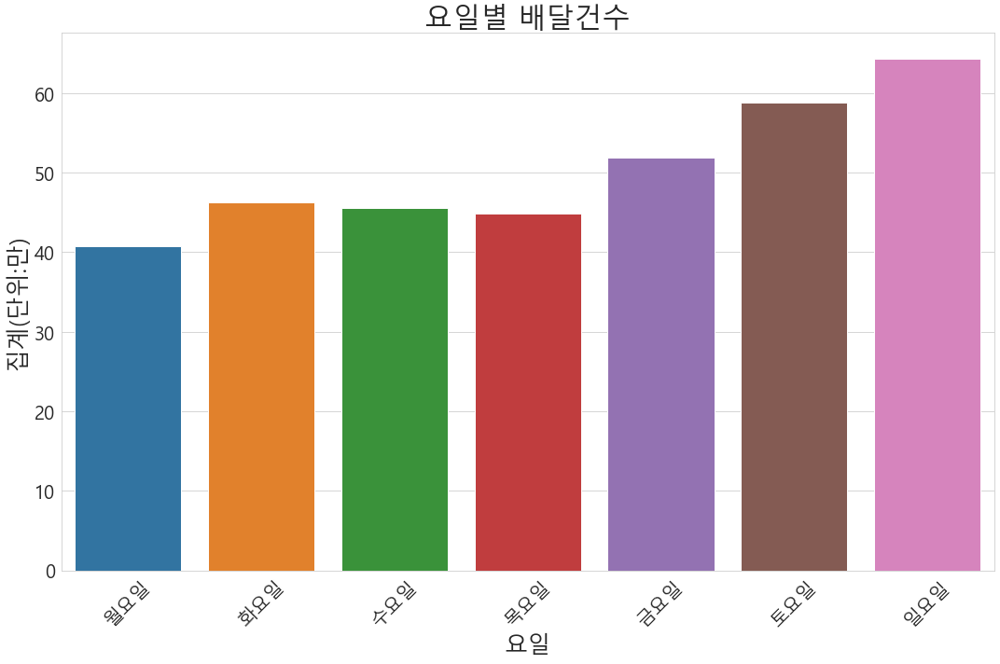

In [41]:
dayofweek_df = df.groupby("요일", as_index=False).size()
dayofweek_df = pd.DataFrame(dayofweek_df)
dayofweek_df

plt.figure(figsize=(15,10))
sns.barplot(x='요일', y=dayofweek_df['size']/10000,data=dayofweek_df, order=['월요일','화요일','수요일','목요일','금요일','토요일','일요일'])
plt.title('요일별 배달건수', fontsize=30)
plt.ylabel("집계(단위:만)", fontsize=25)
plt.xlabel("요일", fontsize=25)
plt.xticks(rotation=45,fontsize=20)
plt.yticks(fontsize=20)
plt.tight_layout()
plt.show()

#### 4. 전체배달건수 파악

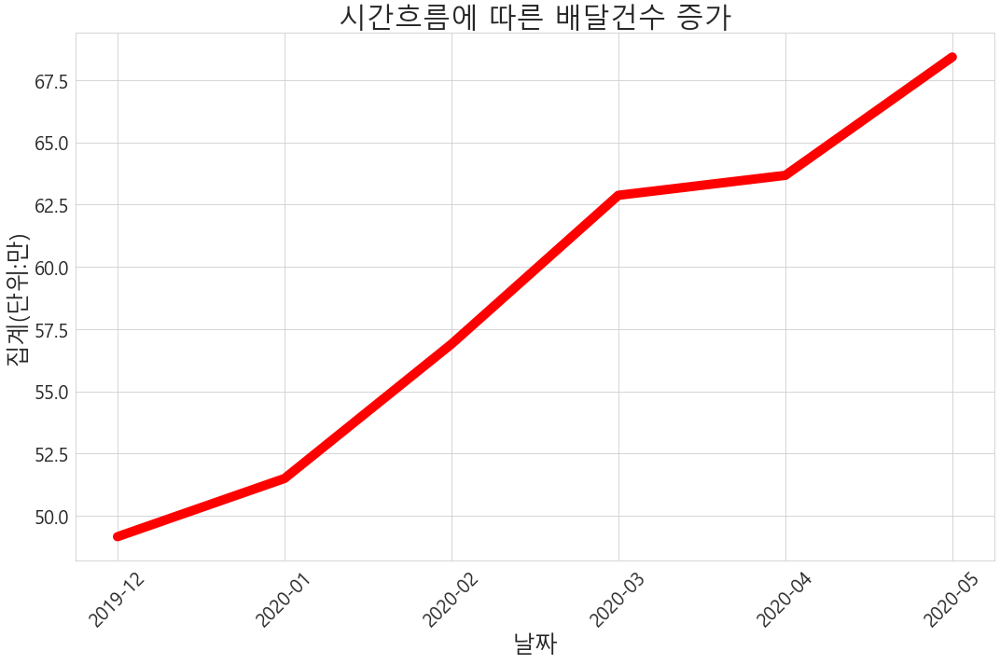

In [42]:

# 시간별 배달건수
time_df = df.groupby("Date", as_index=False).size()
time_df = pd.DataFrame(time_df)

plt.figure(figsize=(15,10))
sns.lineplot(x='Date', y=time_df['size']/10000,data=time_df, linewidth=10, color='red')
plt.title('시간흐름에 따른 배달건수 증가', fontsize=30)
plt.ylabel("집계(단위:만)", fontsize=25)
plt.xlabel("날짜", fontsize=25)
plt.xticks(rotation=45,fontsize=20)
plt.yticks(fontsize=20)
plt.tight_layout()
plt.show()

#### 5. 평균배달소요시간 파악

In [43]:
# 시간흐름에 따른 배달시간 평균 변화
# 배달시간 이상치 확인
print(df['총배달시간'].quantile(q=0.995, interpolation='nearest'))
print(df['총배달시간'].quantile(q=0.05, interpolation='nearest'))

# 상식선에서 생각할 때 총배달시간이 10분 이내인 것은 이해할 수 없다.
# 총배달시간이 1시간 넘게 걸리는 것은... 용서할 수 없다!!!
# 버릴지 말지 고민 중 ==> 우선 카테고리별로 보자 / 카페 디저트는 빠르게 배달할 수도 있으니까

0 days 01:11:43
0 days 00:10:47


,Date,배달시간계산
0,2019-12,26.360012
1,2020-01,25.344430
2,2020-02,27.312893
3,2020-03,25.297263
4,2020-04,24.012227
5,2020-05,24.898384


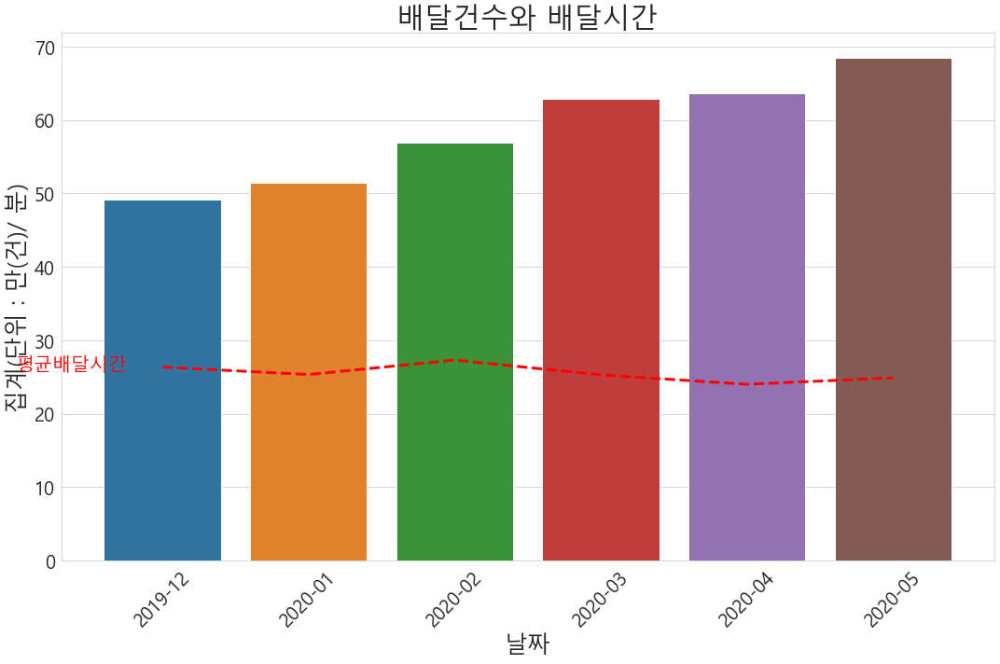

In [44]:
delivery_time_df = df[['Date', '배달상점 업종명', '광역시도명', '시군구명', '배달시간계산']]
time_check = delivery_time_df.groupby('Date', as_index=False).mean()
display(time_check)

# 전체 배달건에 따른 시각화

plt.figure(figsize=(15,10))
sns.barplot(x='Date', y=time_df['size']/10000,data=time_df)
sns.lineplot(x='Date', y='배달시간계산',data=time_check, color='red', linewidth=3, linestyle='--')
plt.title('배달건수와 배달시간', fontsize=30)
plt.ylabel("집계(단위 : 만(건)/ 분)", fontsize=25)
plt.xlabel("날짜", fontsize=25)
plt.text(-1,26,"평균배달시간", fontsize=20, color="red")
plt.xticks(rotation=45,fontsize=20)
plt.yticks(fontsize=20)
plt.tight_layout()
plt.show()

#### 6. 카테고리별 평균배달소요시간

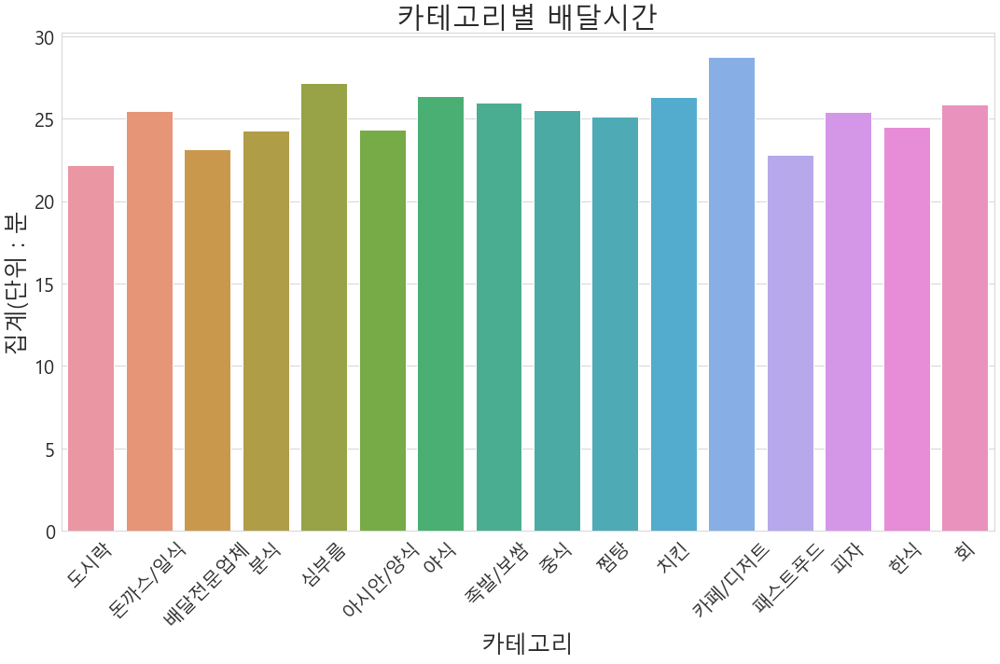

In [45]:
# 카테고리별 평균배달시간 확인

category_time_df = delivery_time_df.groupby(['배달상점 업종명'], as_index=False).mean()
category_time_df


plt.figure(figsize=(15,10))
sns.barplot(x='배달상점 업종명', y=category_time_df['배달시간계산'],data=category_time_df)
plt.title('카테고리별 배달시간', fontsize=30)
plt.ylabel("집계(단위 : 분", fontsize=25)
plt.xlabel("카테고리", fontsize=25)
plt.xticks(rotation=45,fontsize=20)
plt.yticks(fontsize=20)
plt.tight_layout()
plt.show()

# # ?!?!!???? 카페디저트가 제일 오래걸린다?

#### 7. 행정구별 평균배달시간 파악

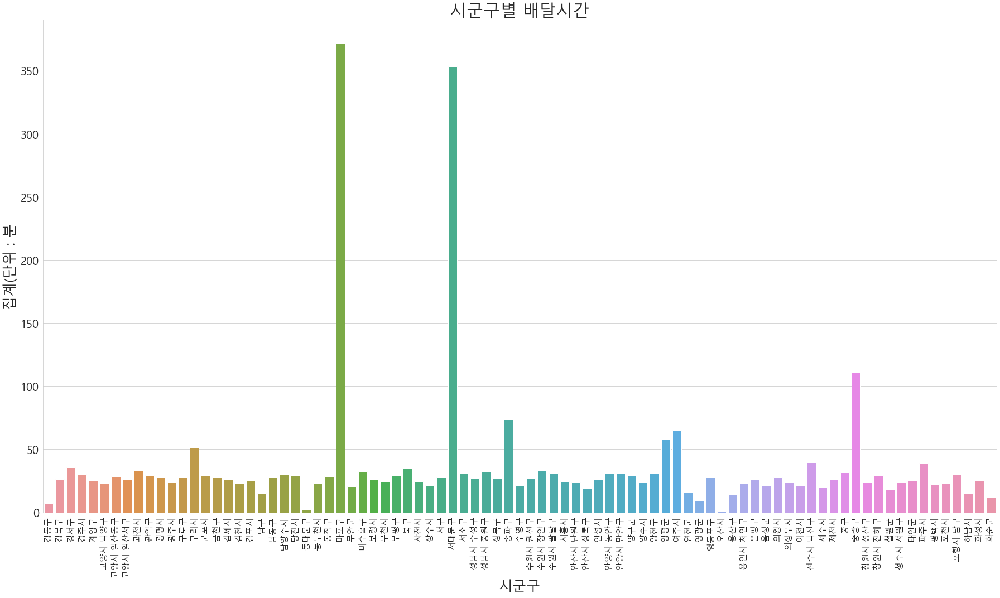

In [46]:
# 행정구별 구분
hangjeong = delivery_time_df.groupby('시군구명', as_index=False).mean()

plt.figure(figsize=(25,15))
sns.barplot(x='시군구명', y=hangjeong['배달시간계산'],data=hangjeong)
plt.title('시군구별 배달시간', fontsize=30)
plt.ylabel("집계(단위 : 분", fontsize=25)
plt.xlabel("시군구", fontsize=25)
plt.xticks(rotation=90,fontsize=15)
plt.yticks(fontsize=20)
plt.tight_layout()
plt.show()

# 평균이 120분 넘는 곳들은 뭐냐?

In [47]:
# 이상치 찾아내기
over_time = hangjeong[hangjeong['배달시간계산'] > 50]
print(over_time['시군구명'].unique())

query1 = "시군구명 in ('구리시', '마포구', '서대문구', '송파구', '양평군', '여주시', '중랑구')"
check_over_time = df.query(query1)

# 특정 배달요청업체ID 값들을 갖는 놈이 배달시간이 길다
# 해당 아이디를 제거하고 평균배달시간과 카테고리별 평균배달시간 시각화 진행

check_over_time = check_over_time[check_over_time['배달시간계산'] > 50]
check_over_time

['구리시' '마포구' '서대문구' '송파구' '양평군' '여주시' '중랑구']


,처리일시,배달요청업체ID,배달접수업체ID,배달상점ID,배달상점 업종명,배달자ID,배달금액,호출중계수수료금액,상품금액,광역시도명,시군구명,공개 시간,강수 유형명,습도,1시간 강수량 값,기온,풍속,라이더배치시간,픽업이동시간,순수배달시간,총배달시간,배달시간계산,코로나,요일,주문시각분류,Date
9375,2019-12-01,C000040,C000222,S0001980,카페/디저트,D0004159,3700,0,22700,서울특별시,서대문구,20,0,74,0.0,-0.4,1.6,0 days 00:01:19,0 days 01:29:21,0 days 00:00:08,0 days 01:30:48,90.800000,전,일요일,야식,2019-12
9376,2019-12-01,C000040,C000222,S0001980,카페/디저트,D0004159,3700,0,13200,서울특별시,서대문구,20,0,74,0.0,-0.4,1.6,0 days 00:02:16,0 days 01:30:22,0 days 00:00:08,0 days 01:32:46,92.766667,전,일요일,야식,2019-12
11350,2019-12-02,C000040,C000222,S0001980,카페/디저트,D0004159,3700,0,13950,서울특별시,서대문구,14,0,46,0.0,-3.4,0.9,0 days 00:00:20,0 days 01:03:40,0 days 00:00:05,0 days 01:04:05,64.083333,전,월요일,야식,2019-12
12807,2019-12-02,C000040,C000222,S0001980,카페/디저트,D0004159,4000,0,12400,서울특별시,서대문구,01,0,36,0.0,2.7,2.6,0 days 00:00:19,0 days 11:00:18,0 days 00:00:12,0 days 11:00:49,660.816667,전,월요일,야식,2019-12
12808,2019-12-02,C000040,C000222,S0001980,카페/디저트,D0004159,3700,0,12800,서울특별시,서대문구,01,0,36,0.0,2.7,2.6,0 days 00:00:20,0 days 07:09:57,0 days 00:00:08,0 days 07:10:25,430.416667,전,월요일,야식,2019-12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4170533,2020-03-31,C000039,C000482,S0000412,카페/디저트,D0009209,4100,0,13000,서울특별시,중랑구,16,0,39,0.0,12.1,1.6,0 days 00:01:00,0 days 00:01:00,0 days 01:23:00,0 days 01:25:00,85.000000,후,화요일,야식,2020-03
4171853,2020-03-31,C000039,C000482,S0000412,카페/디저트,D0009209,3700,0,13400,서울특별시,중랑구,17,0,39,0.0,11.6,1.1,0 days 00:00:00,0 days 00:01:00,0 days 01:09:00,0 days 01:10:00,70.000000,후,화요일,야식,2020-03
4171854,2020-03-31,C000032,C000482,S0000523,카페/디저트,D0009209,3700,0,22000,서울특별시,중랑구,17,0,39,0.0,11.6,1.1,0 days 00:01:00,0 days 00:01:00,0 days 00:50:00,0 days 00:52:00,52.000000,후,화요일,야식,2020-03
4175949,2020-03-31,C000039,C000367,S0000343,카페/디저트,D0007180,3700,0,12900,경기도,구리시,19,0,35,0.0,12.0,1.9,0 days 00:01:00,0 days 00:28:00,0 days 00:22:00,0 days 00:51:00,51.000000,후,화요일,야식,2020-03


In [48]:
print(check_over_time['배달요청업체ID'].unique())
print(check_over_time['배달요청업체ID'].value_counts())

['C000040' 'C000039' 'C000032' 'C000094']
C000040    943
C000039    730
C000032    109
C000094      1
Name: 배달요청업체ID, dtype: int64


In [49]:
# 해당 이상치 모두 삭제 후 다시 진행
before = len(df)
df = df[(df['배달요청업체ID'] != 'C000040') & (df['배달요청업체ID'] != 'C000032') & (df['배달요청업체ID'] != 'C000039')]
after = len(df)
print("이상치 수 :",before - after)

이상치 수 : 179612


,Date,배달시간계산
0,2019-12,25.955244
1,2020-01,24.957371
2,2020-02,26.720551
3,2020-03,24.918575
4,2020-04,23.672788
5,2020-05,24.587071


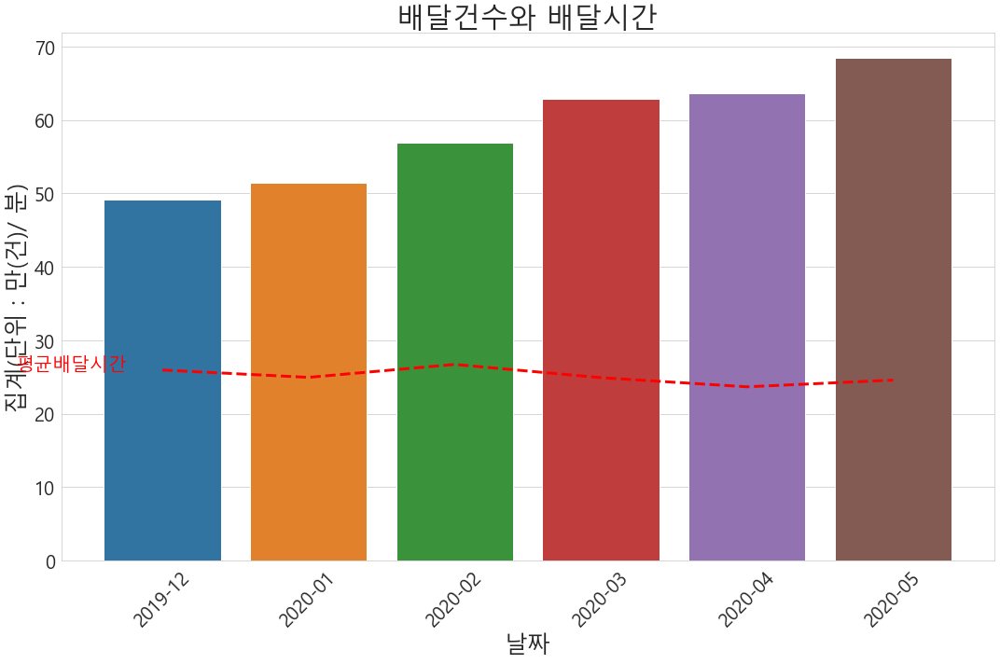

In [50]:
### 평균배달소요시간 다시!!
delivery_time_df = df[['Date', '배달상점 업종명', '광역시도명', '시군구명', '배달시간계산']]
time_check = delivery_time_df.groupby('Date', as_index=False).mean()
display(time_check)

# 전체 배달건에 따른 시각화
plt.figure(figsize=(15,10))
sns.barplot(x='Date', y=time_df['size']/10000,data=time_df)
sns.lineplot(x='Date', y='배달시간계산',data=time_check, color='red', linewidth=3, linestyle='--')
plt.title('배달건수와 배달시간', fontsize=30)
plt.ylabel("집계(단위 : 만(건)/ 분)", fontsize=25)
plt.xlabel("날짜", fontsize=25)
plt.text(-1,26,"평균배달시간", fontsize=20, color="red")
plt.xticks(rotation=45,fontsize=20)
plt.yticks(fontsize=20)
plt.tight_layout()
plt.show()

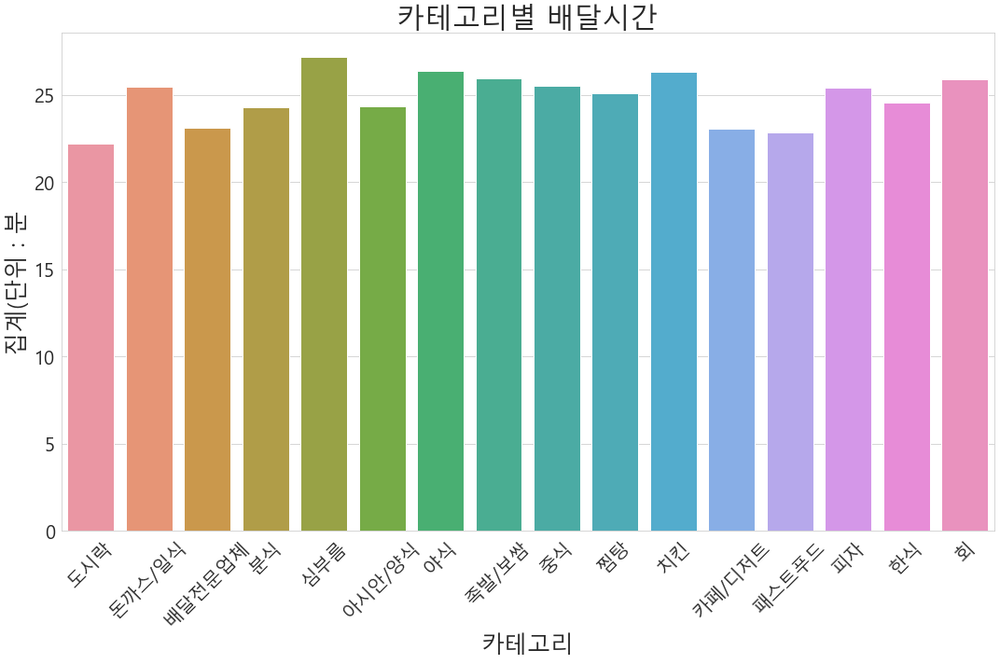

In [51]:
# 카테고리별 평균배달시간 다시!!!
category_time_df = delivery_time_df.groupby(['배달상점 업종명'], as_index=False).mean()
category_time_df

plt.figure(figsize=(15,10))
sns.barplot(x='배달상점 업종명', y=category_time_df['배달시간계산'],data=category_time_df)
plt.title('카테고리별 배달시간', fontsize=30)
plt.ylabel("집계(단위 : 분", fontsize=25)
plt.xlabel("카테고리", fontsize=25)
plt.xticks(rotation=45,fontsize=20)
plt.yticks(fontsize=20)
plt.tight_layout()
plt.show()

# 카페 / 디저트가 눈에 띄게 줄어듦

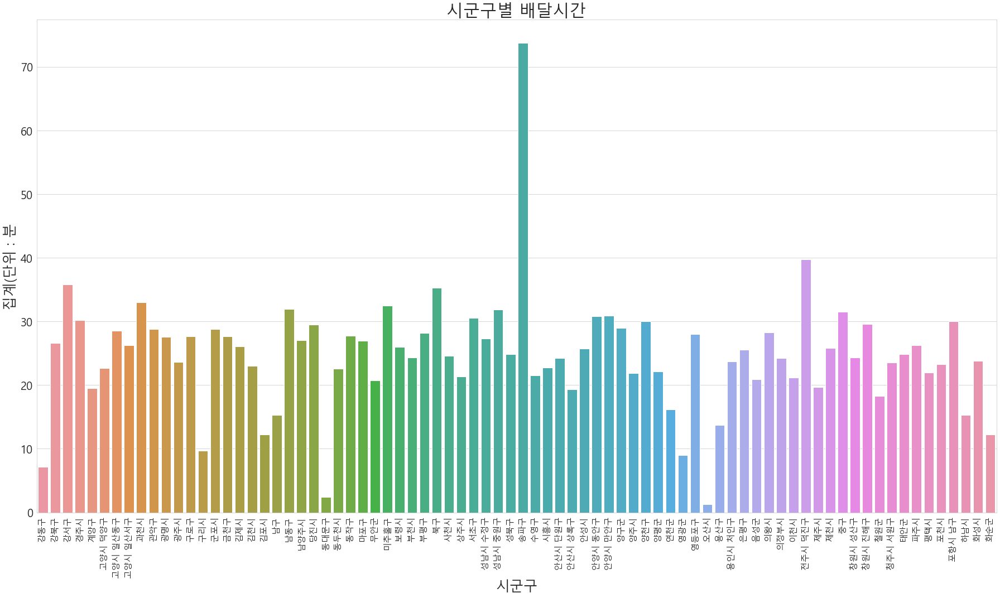

In [52]:
### 행정구별 평균배달시간 다시!!!
# 행정구별 구분
hangjeong = delivery_time_df.groupby('시군구명', as_index=False).mean()

plt.figure(figsize=(25,15))
sns.barplot(x='시군구명', y=hangjeong['배달시간계산'],data=hangjeong)
plt.title('시군구별 배달시간', fontsize=30)
plt.ylabel("집계(단위 : 분", fontsize=25)
plt.xlabel("시군구", fontsize=25)
plt.xticks(rotation=90,fontsize=15)
plt.yticks(fontsize=20)
plt.tight_layout()
plt.show()


# 송파구 이상치 존재..? 

In [53]:
songpa = df[df['시군구명'] == '송파구']
songpa
# 데이터가 1개, 해당 데이터는 이상치가 아닌 특이치

,처리일시,배달요청업체ID,배달접수업체ID,배달상점ID,배달상점 업종명,배달자ID,배달금액,호출중계수수료금액,상품금액,광역시도명,시군구명,공개 시간,강수 유형명,습도,1시간 강수량 값,기온,풍속,라이더배치시간,픽업이동시간,순수배달시간,총배달시간,배달시간계산,코로나,요일,주문시각분류,Date
1341135,2020-02-04,C000094,C000094,S0000776,치킨,D0008606,5600,300,1000,서울특별시,송파구,21,0,41,0.0,-9.0,1.8,0 days 00:39:36,0 days 00:10:53,0 days 00:23:13,0 days 01:13:42,73.7,전,화요일,야식,2020-02


#### 8. 카테고리별 평균값&중앙값

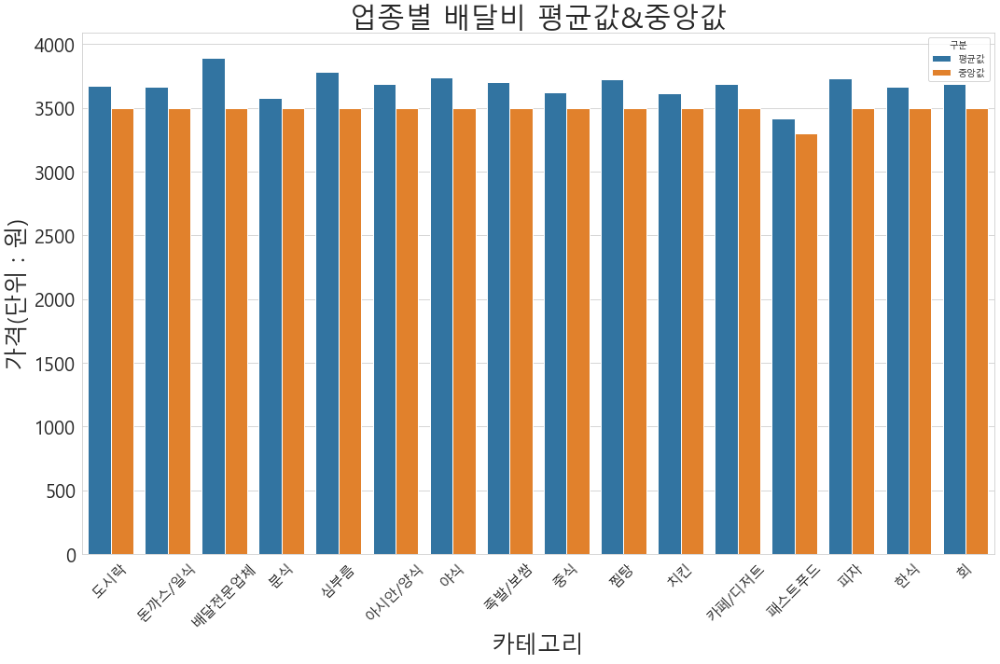

In [54]:
# 카테고리별 평균값 분류
category_price_mean = df.groupby(['배달상점 업종명'], as_index=False).mean()

# 카테고리별 중앙값 분류 
category_price_median = df.groupby(['배달상점 업종명'], as_index=False).median() 

category_price_mean = category_price_mean[['배달상점 업종명', '배달금액', '호출중계수수료금액', '상품금액', '배달시간계산']]
category_price_median = category_price_median[['배달상점 업종명', '배달금액', '호출중계수수료금액', '상품금액', '배달시간계산']]

category_price_mean['구분'] = "평균값"
category_price_median['구분'] = '중앙값'

new_df = pd.concat([category_price_mean,category_price_median], axis=0)
new_df.head(1)

# 카테고리별 평균배달비

plt.figure(figsize=(15,10))
sns.barplot(x='배달상점 업종명', y='배달금액',hue='구분',data=new_df)
plt.title('업종별 배달비 평균값&중앙값', fontsize=30)
plt.ylabel("가격(단위 : 원)", fontsize=25)
plt.xlabel("카테고리", fontsize=25)
plt.xticks(rotation=45,fontsize=15)
plt.yticks(fontsize=20)
plt.tight_layout()
plt.show()

# 배달비의 평균값은 거의 모두 3500원이다.

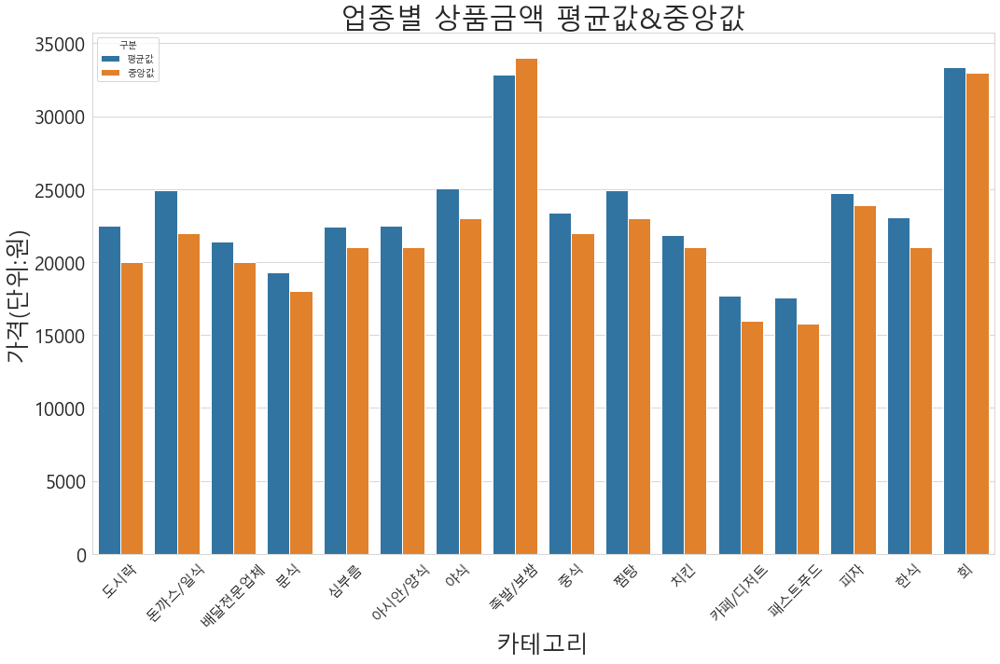

In [55]:
# 카테고리별 상품금액

plt.figure(figsize=(15,10))
sns.barplot(x='배달상점 업종명', y='상품금액',hue='구분',data=new_df)
plt.title('업종별 상품금액 평균값&중앙값', fontsize=30)
plt.ylabel("가격(단위:원)", fontsize=25)
plt.xlabel("카테고리", fontsize=25)
plt.xticks(rotation=45,fontsize=15)
plt.yticks(fontsize=20)
plt.tight_layout()
plt.show()

# 족발/보쌈을 제외하면 중앙값이 평균값보다 낮다.
# 족발 보쌈은 가게별 차이가 크지 않은 것으로 판단된다.
# 회와 족발/보쌈은 부르주아 메뉴다
# 대체로 25000원 아래 가격대로 상품가격이 형성된다.

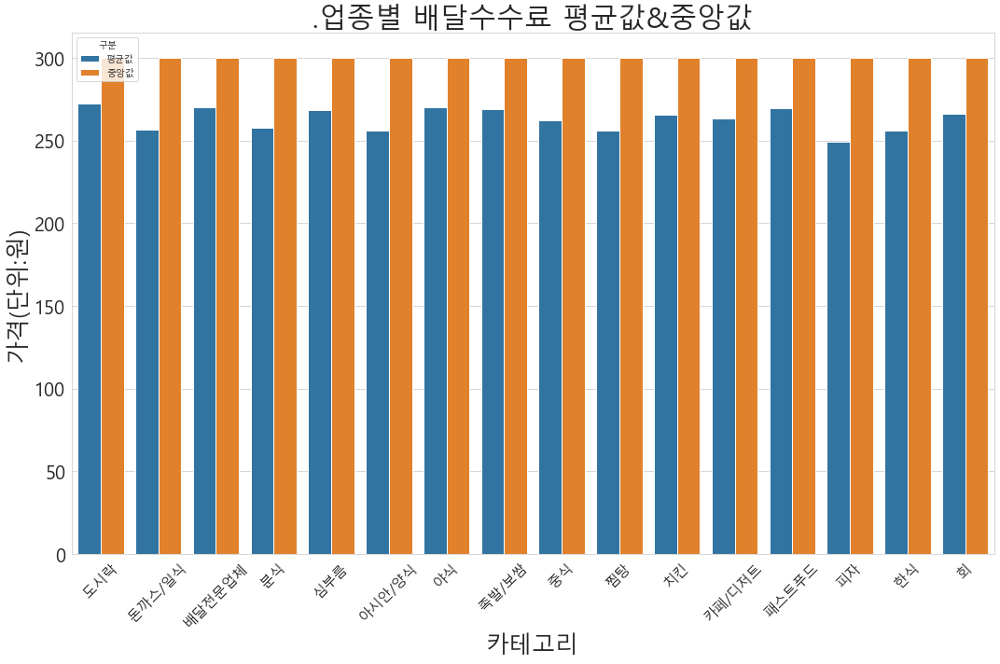

In [56]:
# 카테고리별 평균배달수수료

plt.figure(figsize=(15,10))
sns.barplot(x='배달상점 업종명', y='호출중계수수료금액',hue='구분',data=new_df)
plt.title('.업종별 배달수수료 평균값&중앙값', fontsize=30)
plt.ylabel("가격(단위:원)", fontsize=25)
plt.xlabel("카테고리", fontsize=25)
plt.xticks(rotation=45,fontsize=15)
plt.yticks(fontsize=20)
plt.tight_layout()
plt.show()

# 중앙값이 모두 동일하다.

#### 9. 서울 데이터 시각화

In [57]:
# 전국으로 보려면 너무 크니까, 서울만 한정해서 보자

seoul = df[df['광역시도명']=='서울특별시']
seoul = seoul[['시군구명','배달상점 업종명', '배달금액', '호출중계수수료금액', '상품금액', '배달시간계산']]

seoul_mean = seoul.groupby(['시군구명','배달상점 업종명'], as_index=False).mean()
seoul_median = seoul.groupby(['시군구명','배달상점 업종명'], as_index=False).median()

seoul_mean['구분'] = '평균값'
seoul_median['구분'] = '중앙값'

new_df2 = pd.concat([seoul_mean, seoul_median], axis=0)

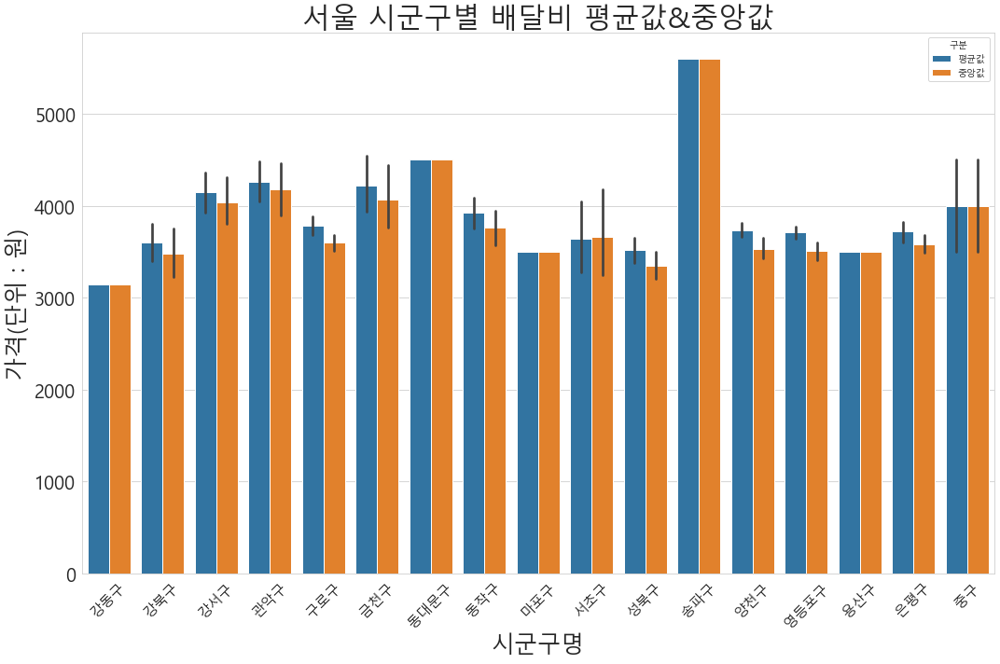

In [58]:
## 배달비 평균 & 중앙
plt.figure(figsize=(15,10))
sns.barplot(x='시군구명', y='배달금액',hue='구분',data=new_df2)
plt.title('서울 시군구별 배달비 평균값&중앙값', fontsize=30)
plt.ylabel("가격(단위 : 원)", fontsize=25)
plt.xlabel("시군구명", fontsize=25)
plt.xticks(rotation=45,fontsize=15)
plt.yticks(fontsize=20)
plt.tight_layout()
plt.show()

# 모든 구가 있지는 않다.
# 배달비는 구에 따라 큰 차이를 보인다. (공시지가와 연결해야 할 것 같다.)
# 송파구는 데이터가 1개이다.

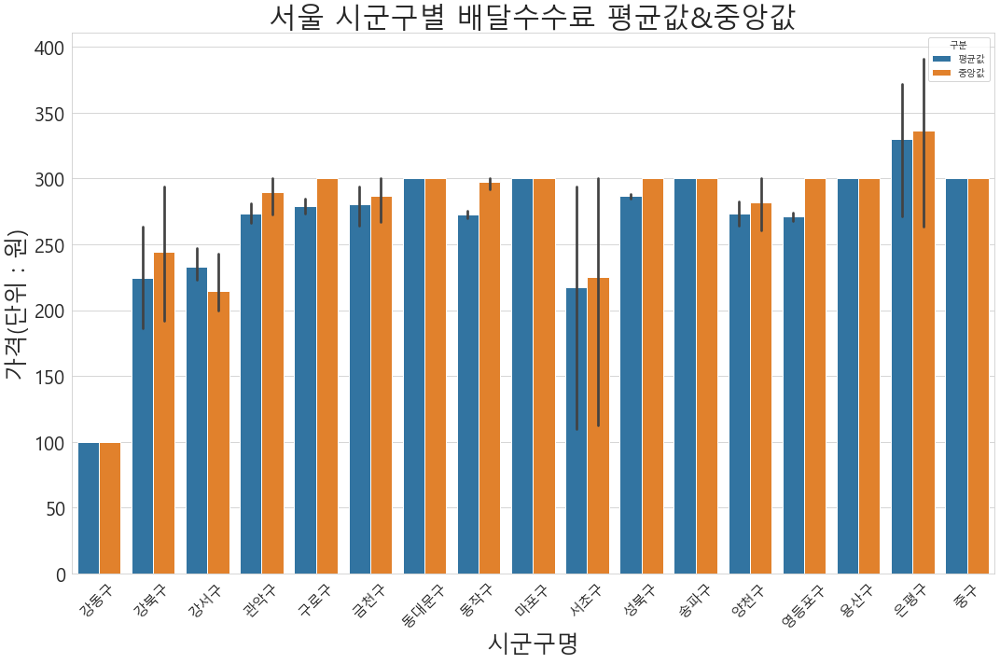

In [59]:
## 호출중계수수료 평균 & 중앙
plt.figure(figsize=(15,10))
sns.barplot(x='시군구명', y='호출중계수수료금액',hue='구분',data=new_df2)
plt.title('서울 시군구별 배달수수료 평균값&중앙값', fontsize=30)
plt.ylabel("가격(단위 : 원)", fontsize=25)
plt.xlabel("시군구명", fontsize=25)
plt.xticks(rotation=45,fontsize=15)
plt.yticks(fontsize=20)
plt.tight_layout()
plt.show()

# 모든 구가 있지는 않다.
# 배달수수료는 대체로 200-300원대를 형성하고 있지만, 특정 구는 더 낮은 것으로 파악된다. ==> 데이터의 수가 적을 것이다.
# 해당 지역 데이터가 적은 것인지, 데이터 오류인 것인지, 아니면 실제 구마다 혜택이 다른 것인지 파악이 필요하다.
# 은평구는 다른 곳보다 수수료가 높다. 해당 지역에 대한 데이터 수도 살펴보아야 한다.

In [60]:
seoul['시군구명'].value_counts()
# 강동구, 마포구, 중구, 송파구, 동대문구, 용산구 데이터는 없어도 무방
# 은평구는 데이터가 많음에도 불구하고 수수료가 비싸다    =======>> 배달수수료에 대한 접근 필요


구로구     322862
금천구     139447
영등포구    112486
은평구      58238
동작구      27017
관악구      25927
양천구      24106
서초구       6432
강북구       6172
성북구       2803
강서구        777
강동구          4
마포구          4
중구           2
송파구          1
동대문구         1
용산구          1
Name: 시군구명, dtype: int64

In [61]:
## 상품은 각 카테고리별로 봐야하기에 pass

#### 11. 배달시간과 매출량의 관계 파악

In [62]:
# 상관관계 사전 데이터 준비
shop_id1 = df.groupby('배달상점ID', as_index=False).size()
shop_id1 = pd.DataFrame(shop_id1)

shop_id2 = df.groupby('배달상점ID', as_index=False).mean()
shop_id2 = shop_id2[['배달상점ID', '배달시간계산']]

shop_id = pd.merge(shop_id1, shop_id2, how='inner', on='배달상점ID')
shop_id = shop_id.set_index('배달상점ID')
corr_df = shop_id.corr()
s = corr_df.unstack()

corr_df1 = pd.DataFrame(s[s < 1].sort_values(ascending=False), columns=['corr'])
corr_df1.style.background_gradient(cmap='viridis')

# 음의 상관관계? 
# 0에 가까운 기울기인 것으로 보아 상관관계가 아주 적다고 볼 수 있다.
# 다만 배달시간이 늘어난다는 것은 배달거리가 늘어난다는 것이다. 이는 배달거리가 늘어날수록 매출에 안좋은 영향을 갖는다고 말할 수 있다.

,,corr
size,배달시간계산,-0.160111
배달시간계산,size,-0.160111


#### 12. 코로나 이후 O2O 서비스 업체 규모 확인

100%|████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.14it/s]
No handles with labels found to put in legend.


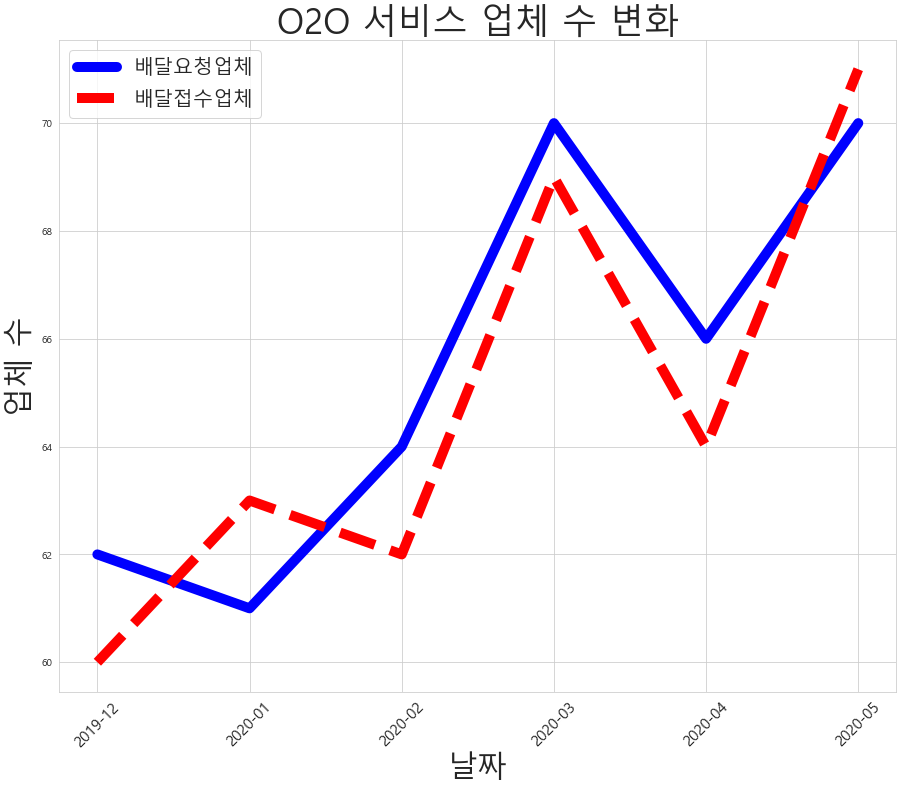

In [63]:
# 코로나 이후 O2O 서비스 형태가 정말 성장했는지 확인하고자 한다.
# 배달요청업체ID	배달접수업체ID를 확인해보자

o2o_food = []
set_o2o_food = []
o2o_deli = []
set_o2o_deli = []

for x in tqdm(date_list) :
    check = df[df['Date']==x]
    o2o_food.append(check['배달요청업체ID'].nunique())
    # set_o2o_food.append(check['배달요청업체ID'].unique())
    o2o_deli.append(check['배달접수업체ID'].nunique())
    # set_o2o_deli.append(check['배달접수업체ID'].unique())

o2o_df = pd.DataFrame([date_list, o2o_food, o2o_deli]).T
o2o_df.columns = ['날짜', '배달요청업체', '배달접수업체']

o2o_df['배달요청업체'] = o2o_df['배달요청업체'].astype(int)
o2o_df['배달접수업체'] = o2o_df['배달접수업체'].astype(int)

plt.figure(figsize=(15,12))
sns.lineplot(data= o2o_df, x= "날짜", y='배달요청업체', color='blue', linewidth=10)
sns.lineplot(data= o2o_df,x= "날짜", y='배달접수업체', color='red', linewidth=10, linestyle='--')
plt.title("O2O 서비스 업체 수 변화", fontsize=35) 
plt.xlabel("날짜", fontsize=30) 
plt.ylabel("업체 수", fontsize=30)
plt.legend()
plt.xticks(rotation=45,fontsize=15)
plt.legend(labels=('배달요청업체', '배달접수업체'), fontsize=20)
plt.show()

#### 13. O2O 서비스 속도 평가

100%|████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<?, ?it/s]


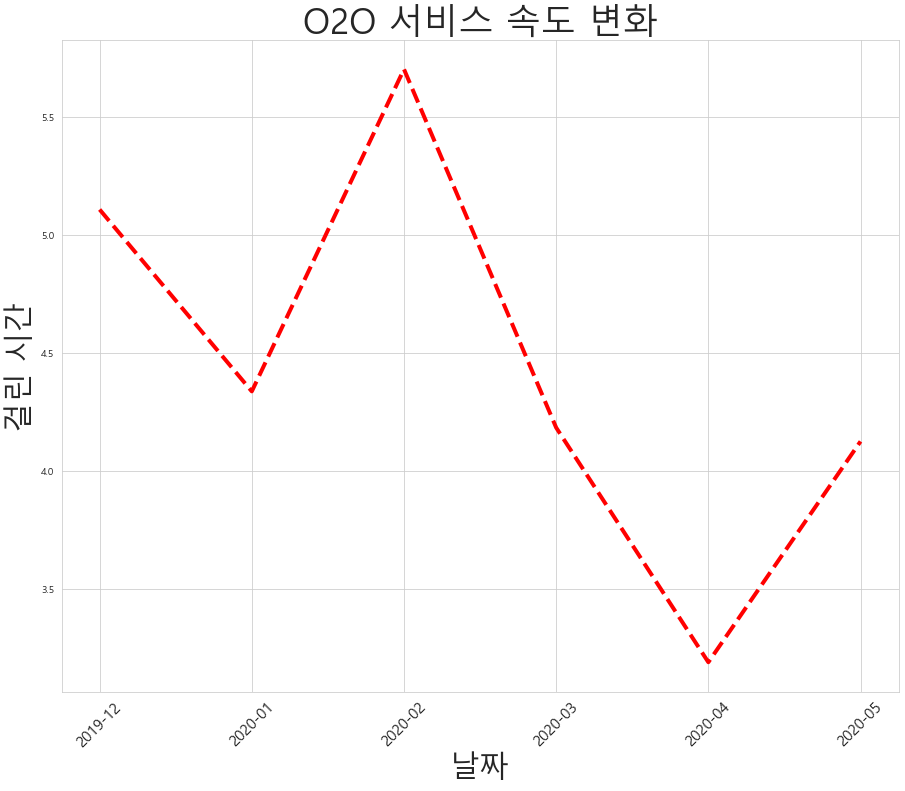

In [64]:
date_list = df['Date'].unique()

time_check = []
for zz in tqdm(date_list) :
  check = df[df['Date']==zz]
  time_check.append(check['라이더배치시간'].mean())

o2o_time = pd.DataFrame([date_list]).T
o2o_time.columns = ["날짜"]

new_list = []
for time in tqdm(time_check) :
    new_list.append(time.total_seconds() / 60)
    
o2o_time['평균라이더배치시간'] = new_list

plt.figure(figsize=(15,12))
sns.lineplot(data= o2o_time, x= "날짜", y='평균라이더배치시간', color='red', linewidth=4, linestyle="--")
plt.title("O2O 서비스 속도 변화", fontsize=35) 
plt.xlabel("날짜", fontsize=30) 
plt.ylabel("걸린 시간", fontsize=30)
plt.xticks(rotation=45,fontsize=15)
plt.show()


## 딱히 서비스가 좋아졌다고 느껴지진 않는다. 아마도 time 입력 오류일 가능성이 크다.
## 큰 차이가 없다.

#### 14. 라이더 배치 속도 평가

100%|████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<?, ?it/s]


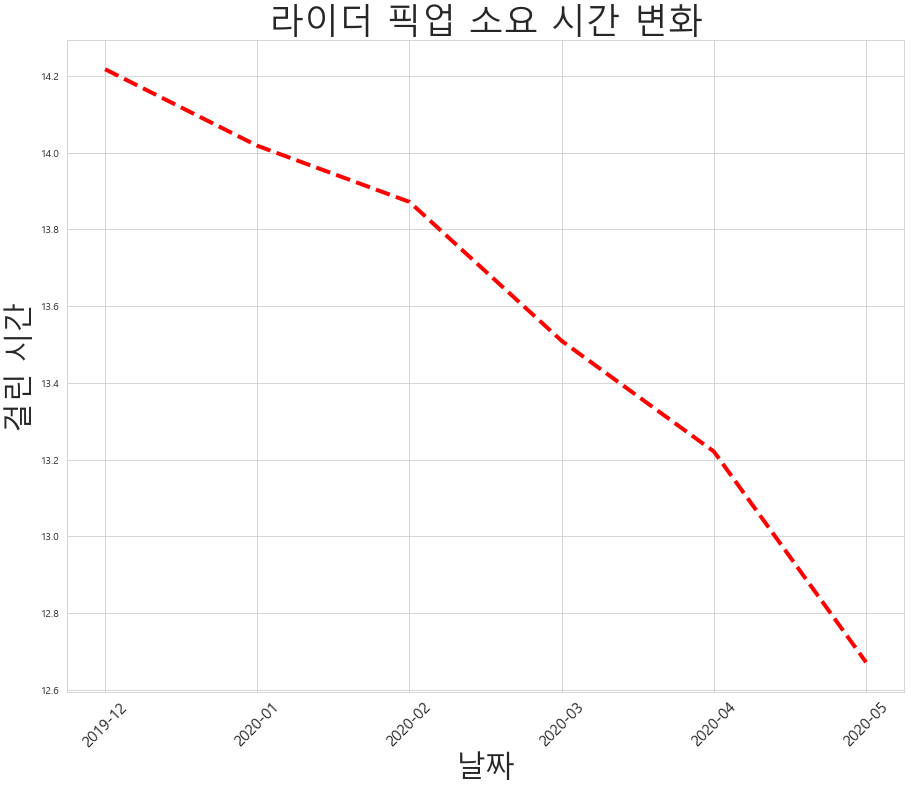

In [65]:
date_list = df['Date'].unique()

time_check = []
for zz in tqdm(date_list) :
    check = df[df['Date']==zz]
    time_check.append(check['픽업이동시간'].mean())

o2o_time = pd.DataFrame([date_list]).T
o2o_time.columns = ["날짜"]

new_list = []
for time in tqdm(time_check) :
    new_list.append(time.total_seconds() / 60)
    
o2o_time['평균픽업이동시간'] = new_list

plt.figure(figsize=(15,12))
sns.lineplot(data= o2o_time, x= "날짜", y='평균픽업이동시간', color='red', linewidth=4, linestyle="--")
plt.title("라이더 픽업 소요 시간 변화", fontsize=35) 
plt.xlabel("날짜", fontsize=30) 
plt.ylabel("걸린 시간", fontsize=30)
plt.xticks(rotation=45,fontsize=15)
plt.show()

## 변화가 있따!!!

#### 15. 라이더 순수 이동시간

100%|██████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 6037.87it/s]


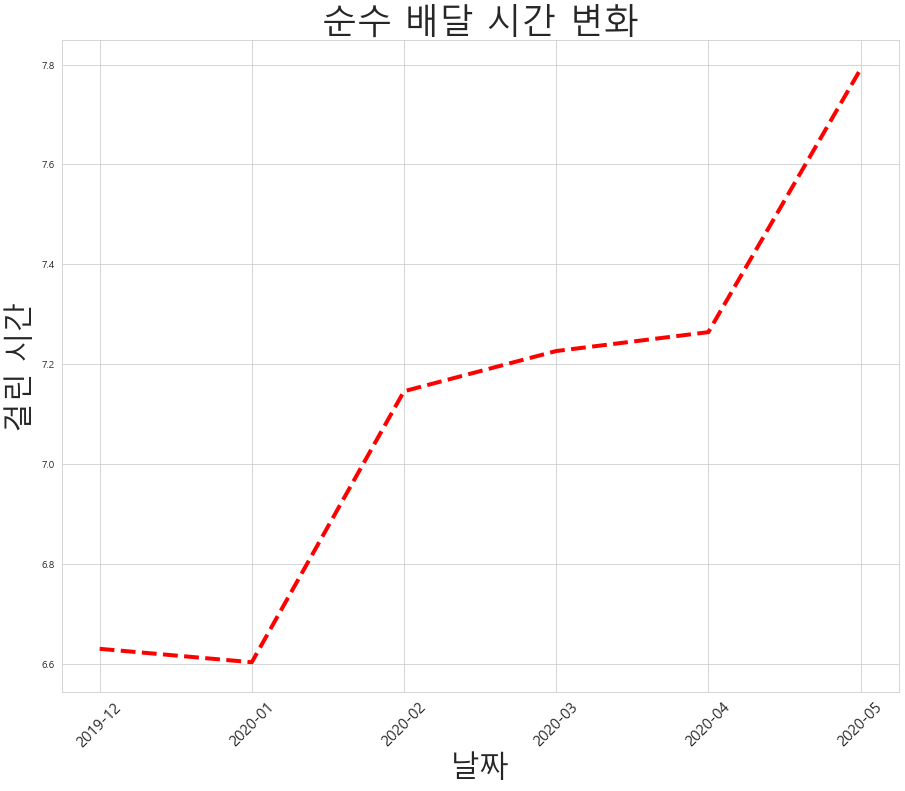

In [66]:
date_list = df['Date'].unique()

time_check = []
for zz in tqdm(date_list) :
    check = df[df['Date']==zz]
    time_check.append(check['순수배달시간'].mean())

o2o_time = pd.DataFrame([date_list]).T
o2o_time.columns = ["날짜"]

new_list = []
for time in tqdm(time_check) :
    new_list.append(time.total_seconds() / 60)
    
o2o_time['평균순수배달시간'] = new_list

plt.figure(figsize=(15,12))
sns.lineplot(data= o2o_time, x= "날짜", y='평균순수배달시간', color='red', linewidth=4, linestyle="--")
plt.title("순수 배달 시간 변화", fontsize=35) 
plt.xlabel("날짜", fontsize=30) 
plt.ylabel("걸린 시간", fontsize=30)
plt.xticks(rotation=45,fontsize=15)
plt.show()

####  코로나 영향에 따른 일일배달건수 단순비교 

- 최초 코로나 확진자 발생일은 1월 20일이나, 영향력을 감안하여 신천지 발생일자를 기준으로 함
- 코로나 발생자 데이터 활용 (일일배달건수는 서울데이터만 활용해야 함)

In [67]:
before_corona = df[df['코로나'] == '전']
after_corona = df[df['코로나'] == '후']

print("코로나 전 데이터 수:",len(before_corona))
print("코로나 후 데이터 수:",len(after_corona))

print("코로나 전 일수:",before_corona['처리일시'].nunique())
print("코로나 후 일수:",after_corona['처리일시'].nunique())

코로나 전 데이터 수: 1275191
코로나 후 데이터 수: 2070400
코로나 전 일수: 79
코로나 후 일수: 103


In [71]:
print("코로나 전 평균일일배달건수 :",round(len(before_corona) / before_corona['처리일시'].nunique()))
print("코로나 후 평균일일배달건수 :",round(len(after_corona) / after_corona['처리일시'].nunique()))

코로나 전 평균일일배달건수 : 16142
코로나 후 평균일일배달건수 : 20101


In [68]:
## 코로나 일일 확진자 수

covid_df = pd.read_csv("./data/covid_19_dataset/Time.csv")
covid_df['date'] = pd.to_datetime(covid_df['date'])
corona_data = covid_df[covid_df['date'] < '2020-06-01']
corona_data.drop("time", axis=1, inplace=True)

per_day_test = [0]
per_day_confirmed = [0]
per_day_released = [0]
per_day_deceased = [0]

for x in range(len(corona_data)-1) :
    per_day_test.append(corona_data['test'].iloc[x+1] - corona_data['test'].iloc[x])
    per_day_confirmed.append(corona_data['confirmed'].iloc[x+1] - corona_data['confirmed'].iloc[x])
    per_day_released.append(corona_data['released'].iloc[x+1] - corona_data['released'].iloc[x])
    per_day_deceased.append(corona_data['deceased'].iloc[x+1] - corona_data['deceased'].iloc[x])

corona_data['per_day_test'] = per_day_test
corona_data['per_day_confirmed'] = per_day_confirmed
corona_data['per_day_released'] = per_day_released
corona_data['per_day_deceased'] = per_day_deceased

corona_data

,date,test,negative,confirmed,released,deceased,per_day_test,per_day_confirmed,per_day_released,per_day_deceased
0,2020-01-20,1,0,1,0,0,0,0,0,0
1,2020-01-21,1,0,1,0,0,0,0,0,0
2,2020-01-22,4,3,1,0,0,3,0,0,0
3,2020-01-23,22,21,1,0,0,18,0,0,0
4,2020-01-24,27,25,2,0,0,5,1,0,0
...,...,...,...,...,...,...,...,...,...,...
128,2020-05-27,852876,820550,11265,10295,269,13401,40,20,0
129,2020-05-28,868666,834952,11344,10340,269,15790,79,45,0
130,2020-05-29,885120,849161,11402,10363,269,16454,58,23,0
131,2020-05-30,902901,865162,11441,10398,269,17781,39,35,0


In [73]:
#### 일일배달건수와 확진자 수

df.groupby('처리일시').size()

처리일시
2019-12-01     7218
2019-12-02    10634
2019-12-03    11934
2019-12-04    11959
2019-12-05    12909
              ...  
2020-05-27    18219
2020-05-28    19117
2020-05-29    22520
2020-05-30    26646
2020-05-31    27057
Length: 182, dtype: int64